In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) 

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

In [2]:
class Generator(nn.Module):
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    return torch.randn(n_samples, input_dim, device=device)

In [3]:
class Discriminator(nn.Module):
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

In [4]:
import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    return F.one_hot(labels, num_classes=n_classes)

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


In [6]:
def combine_vectors(x, y):
    combined = torch.cat((x.float(), y.float()), dim=1)
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

In [9]:
# Set training parameters
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

In [10]:
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.209107609629631, discriminator loss: 0.26632630481570957


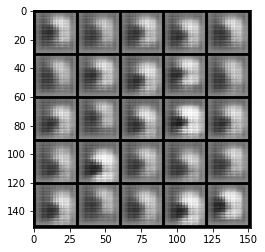

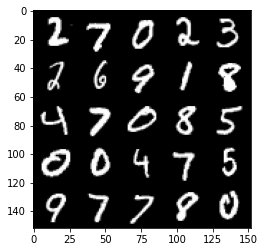

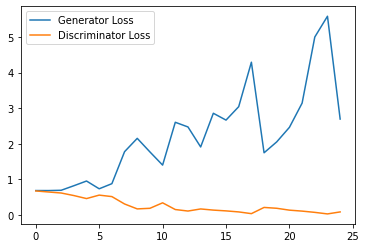

Step 1000: Generator loss: 4.599255725860596, discriminator loss: 0.0485114383706823


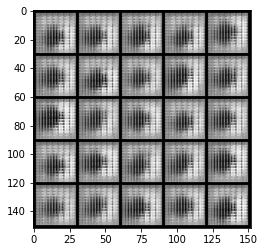

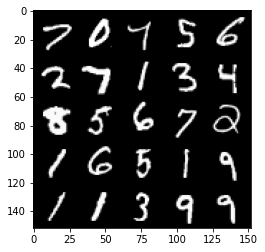

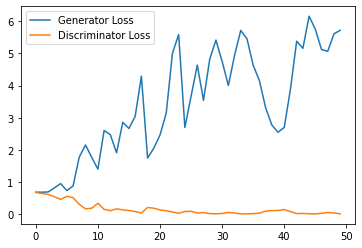

Step 1500: Generator loss: 5.106106901168824, discriminator loss: 0.03553140854556113


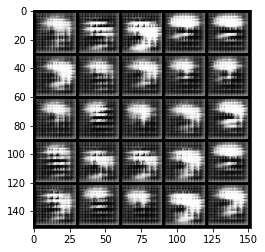

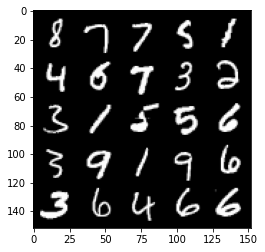

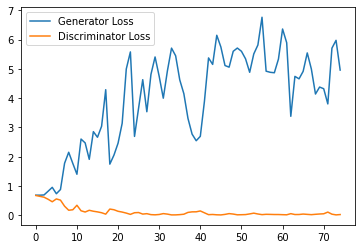

Step 2000: Generator loss: 5.339964059352875, discriminator loss: 0.0265365305095911


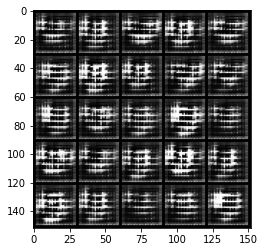

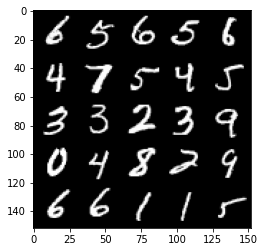

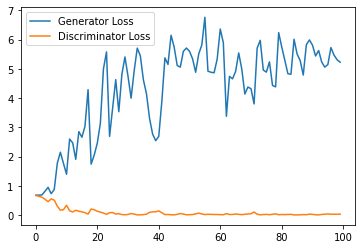

Step 2500: Generator loss: 4.95984858417511, discriminator loss: 0.048986227872315796


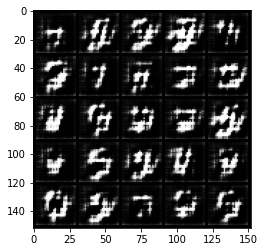

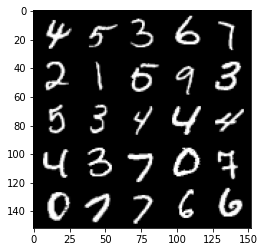

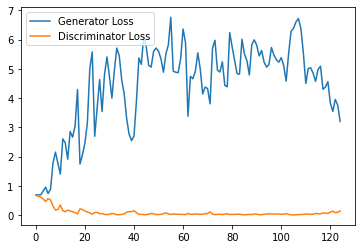

Step 3000: Generator loss: 3.0581121096611024, discriminator loss: 0.16964869497716425


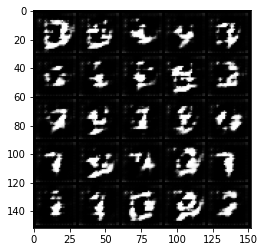

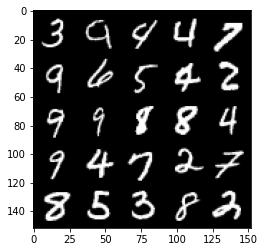

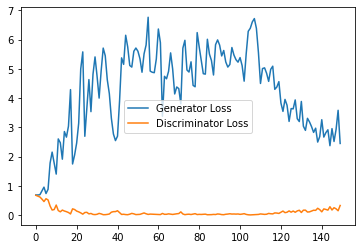

Step 3500: Generator loss: 2.581483332872391, discriminator loss: 0.24888035933673383


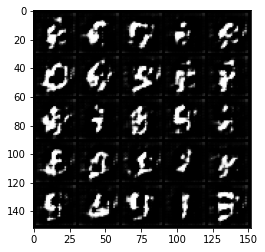

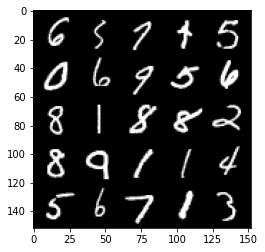

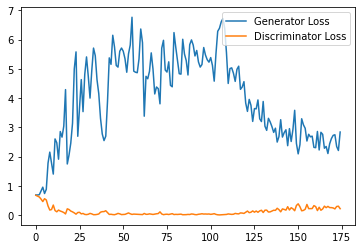

Step 4000: Generator loss: 2.3451585521697997, discriminator loss: 0.28956309163570404


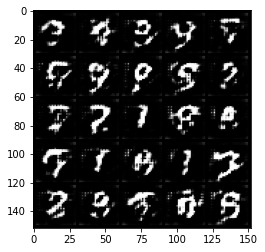

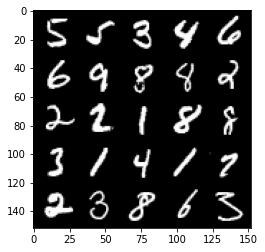

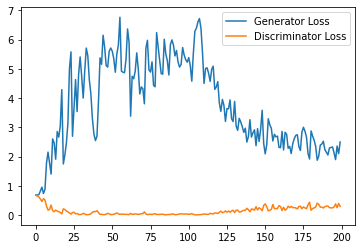

Step 4500: Generator loss: 2.2170616726875307, discriminator loss: 0.3264995491504669


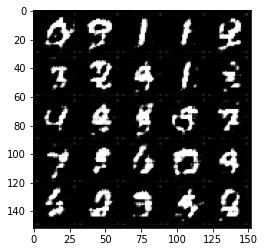

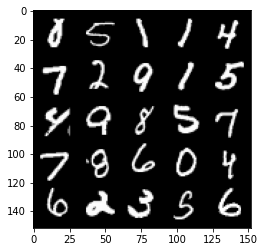

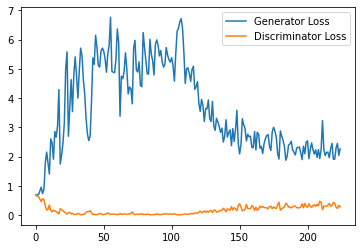

Step 5000: Generator loss: 1.9323652584552764, discriminator loss: 0.33593194127082826


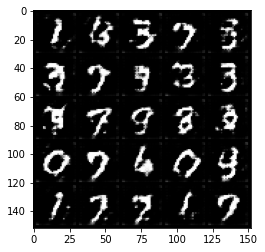

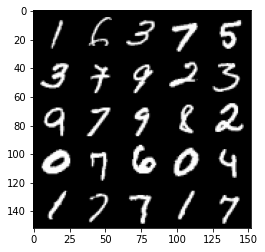

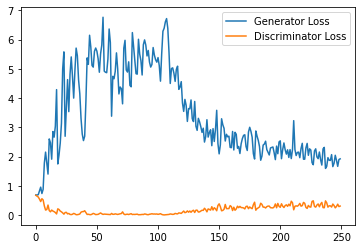

Step 5500: Generator loss: 2.018775597333908, discriminator loss: 0.34066051939129827


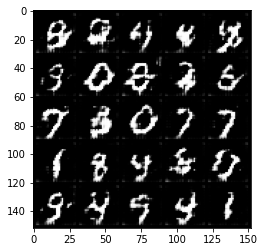

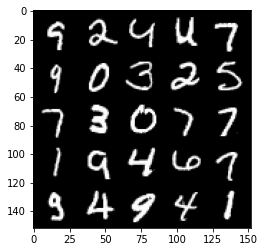

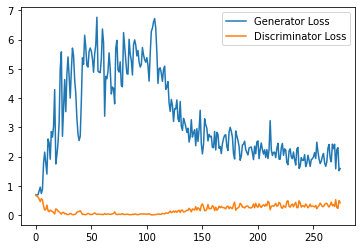

Step 6000: Generator loss: 1.755705263853073, discriminator loss: 0.3653306293785572


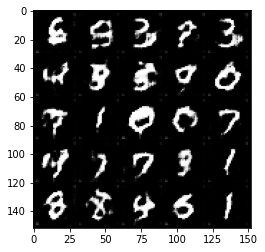

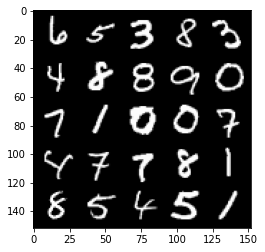

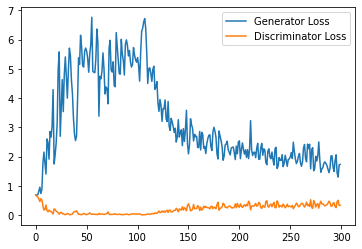

Step 6500: Generator loss: 1.7217358731031418, discriminator loss: 0.385361329138279


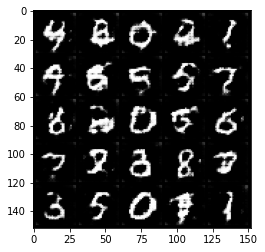

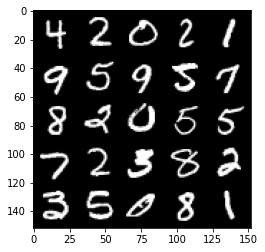

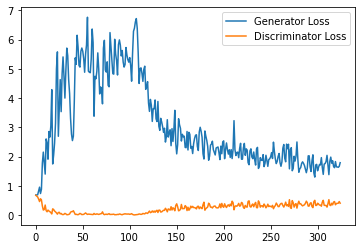

Step 7000: Generator loss: 1.853304660320282, discriminator loss: 0.40569947043061255


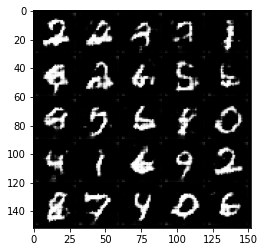

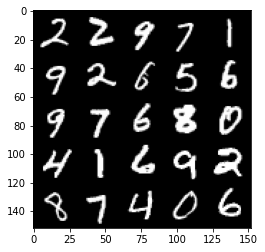

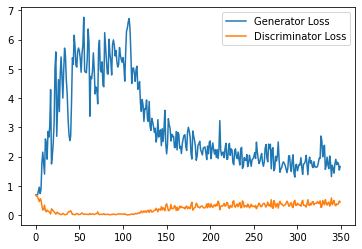

Step 7500: Generator loss: 1.7842079097032546, discriminator loss: 0.4012554626762867


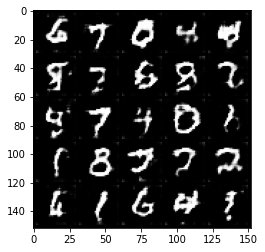

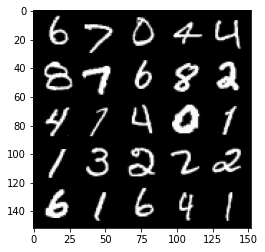

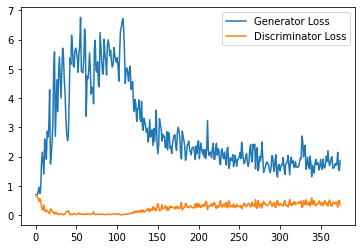

Step 8000: Generator loss: 1.5758113231658935, discriminator loss: 0.42660013297200206


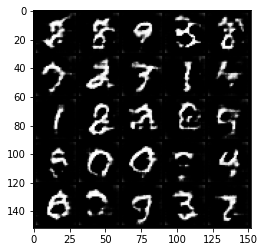

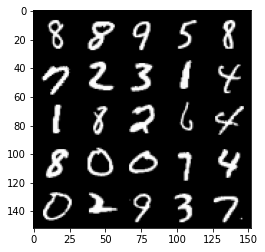

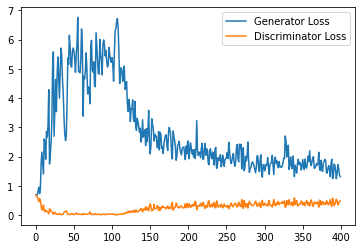

Step 8500: Generator loss: 1.5455722112655639, discriminator loss: 0.4537243218719959


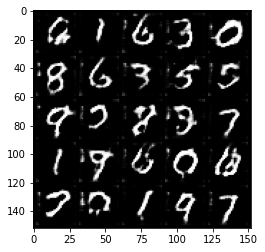

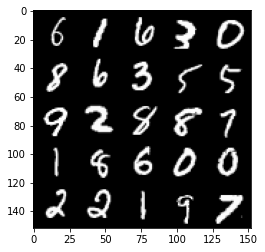

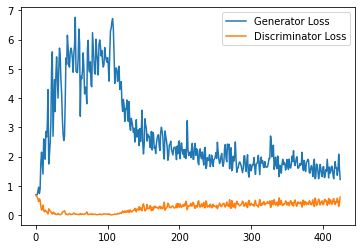

Step 9000: Generator loss: 1.477679660320282, discriminator loss: 0.47915208953619004


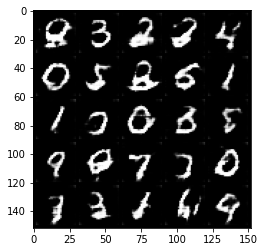

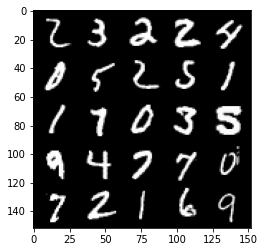

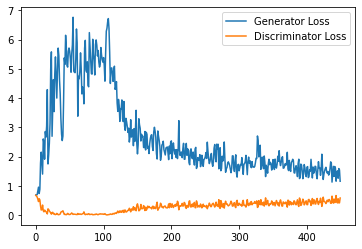

Step 9500: Generator loss: 1.4591651247739792, discriminator loss: 0.492603695333004


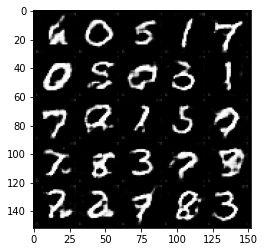

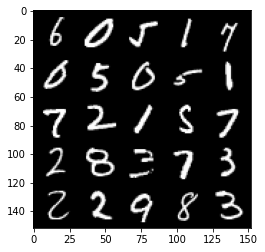

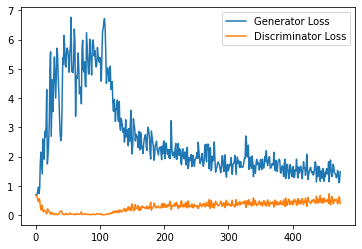

Step 10000: Generator loss: 1.4004716402292252, discriminator loss: 0.5004760665893555


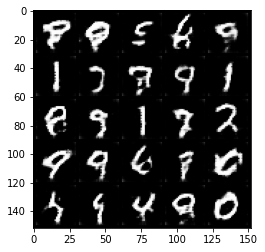

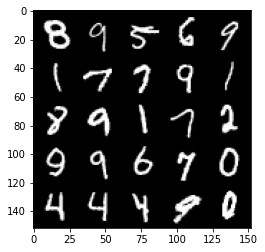

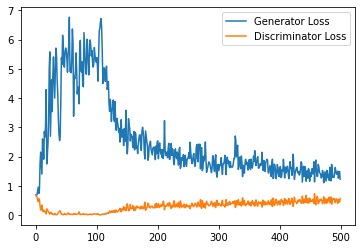

Step 10500: Generator loss: 1.3796307808160782, discriminator loss: 0.511655405163765


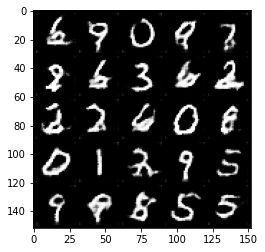

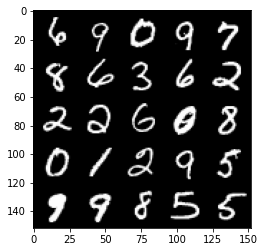

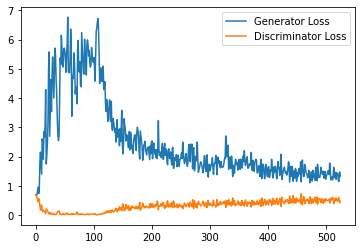

Step 11000: Generator loss: 1.2594501276016234, discriminator loss: 0.5196951209902764


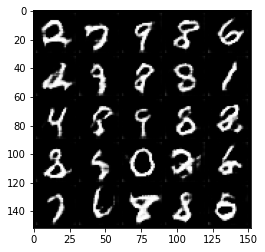

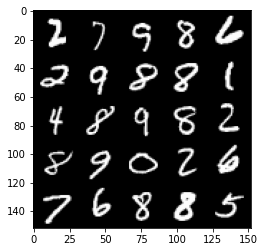

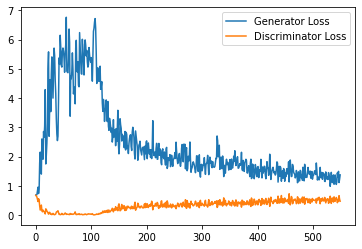

Step 11500: Generator loss: 1.292121809720993, discriminator loss: 0.5311982778310775


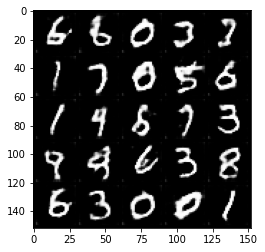

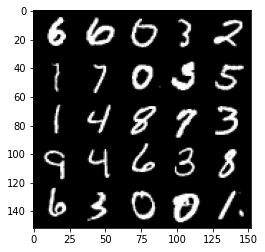

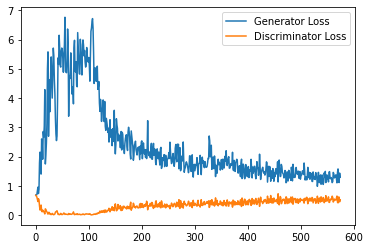

Step 12000: Generator loss: 1.2294611262083053, discriminator loss: 0.5298242750763893


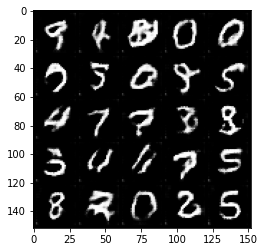

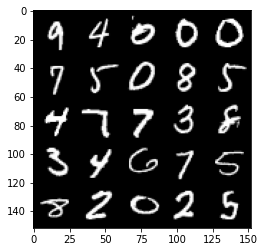

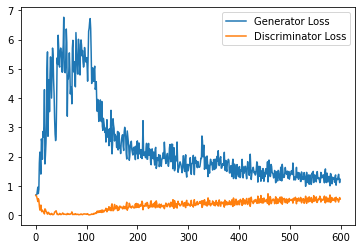

Step 12500: Generator loss: 1.2293581907749176, discriminator loss: 0.5310431857705116


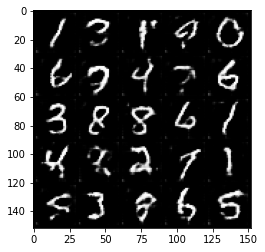

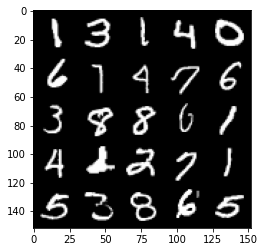

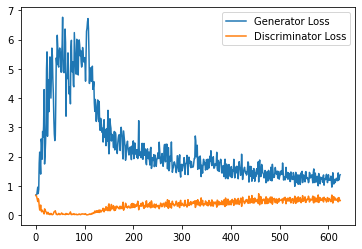

Step 13000: Generator loss: 1.298834265947342, discriminator loss: 0.5523455359339714


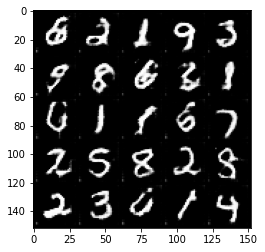

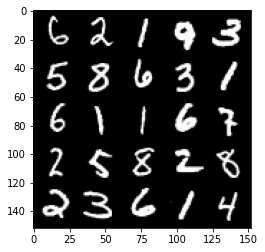

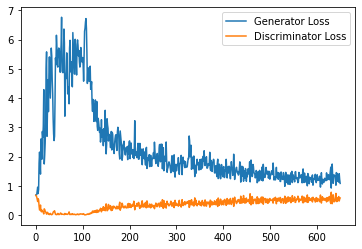

Step 13500: Generator loss: 1.1793554188013078, discriminator loss: 0.5386523973941802


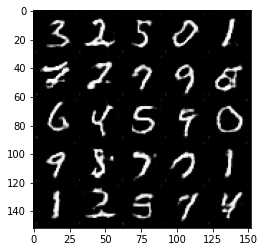

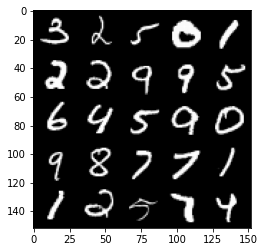

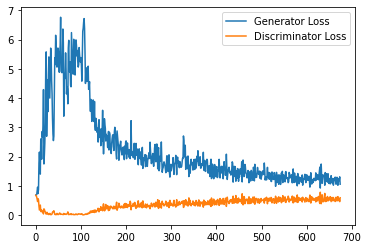

Step 14000: Generator loss: 1.1996813658475876, discriminator loss: 0.5462245156168938


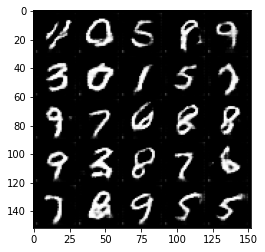

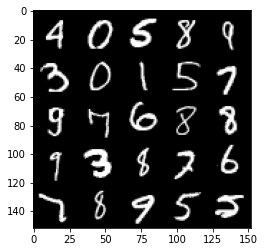

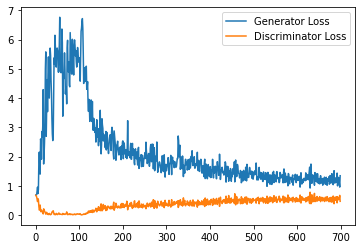

Step 14500: Generator loss: 1.2170330568552017, discriminator loss: 0.5363487611413003


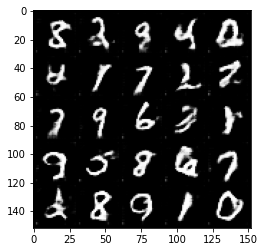

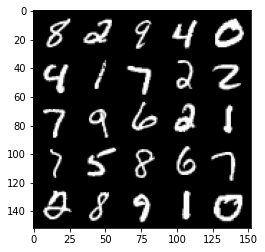

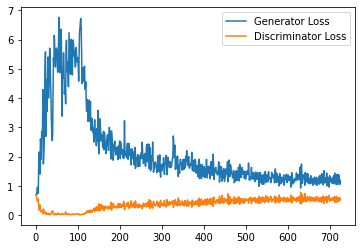

Step 15000: Generator loss: 1.1759929065704346, discriminator loss: 0.5427123125195503


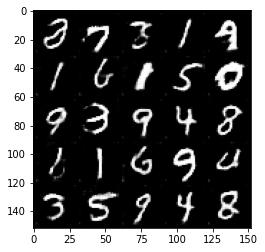

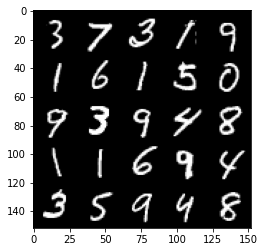

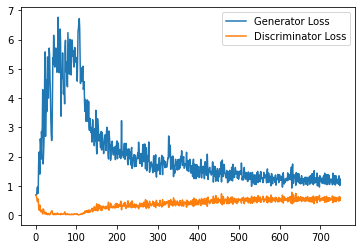

Step 15500: Generator loss: 1.1589205545186996, discriminator loss: 0.5474921146631241


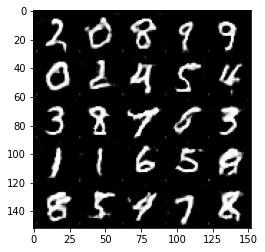

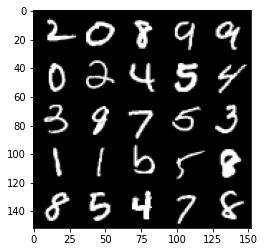

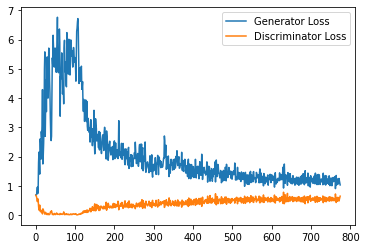

Step 16000: Generator loss: 1.1388133952617645, discriminator loss: 0.5502617907524109


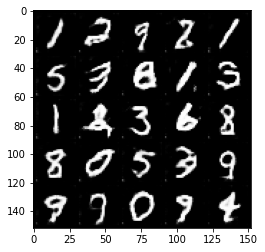

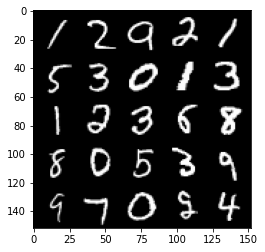

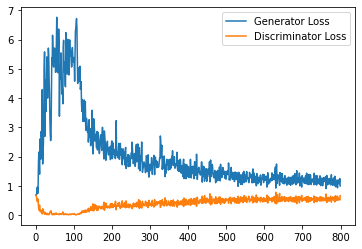

Step 16500: Generator loss: 1.1501838170289993, discriminator loss: 0.5502515560388566


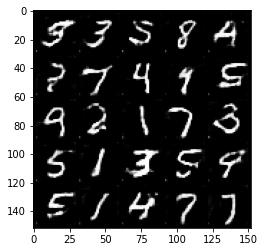

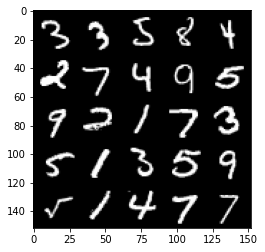

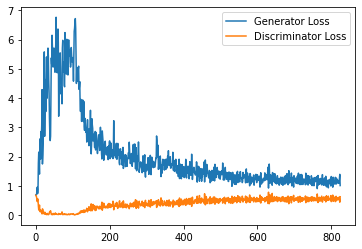

Step 17000: Generator loss: 1.151582235813141, discriminator loss: 0.5522062168121338


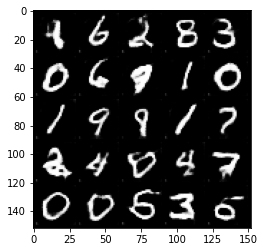

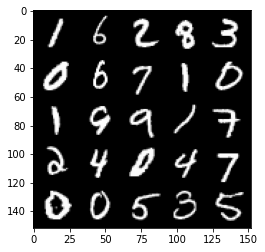

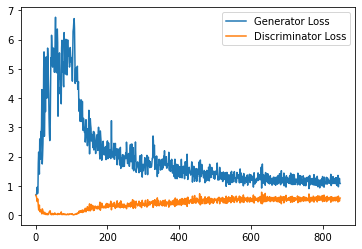

Step 17500: Generator loss: 1.0915056430101395, discriminator loss: 0.5521065424084663


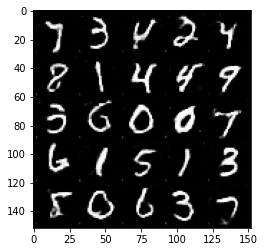

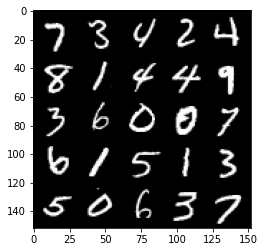

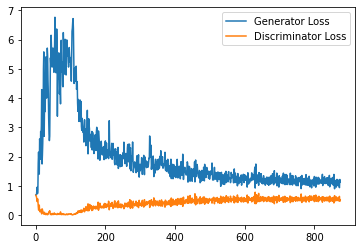

Step 18000: Generator loss: 1.1187613694667815, discriminator loss: 0.5605953837633133


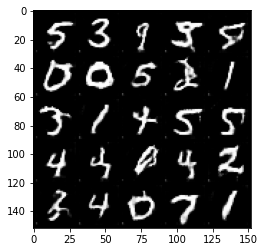

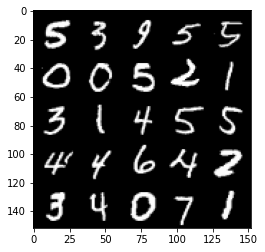

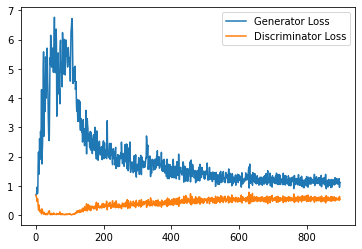

Step 18500: Generator loss: 1.1119693312644958, discriminator loss: 0.5596474061012268


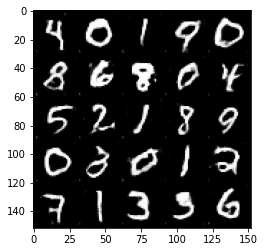

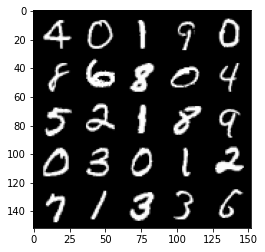

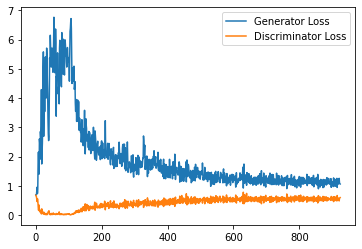

Step 19000: Generator loss: 1.1114539816379547, discriminator loss: 0.5562118457555771


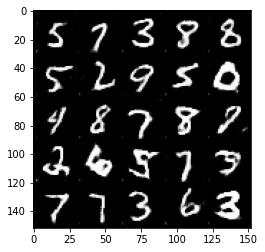

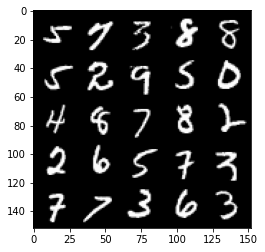

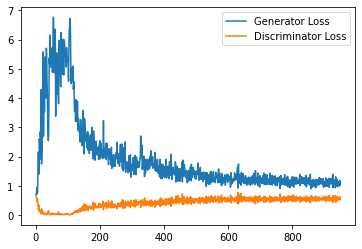

Step 19500: Generator loss: 1.1081041932106017, discriminator loss: 0.5585938208103179


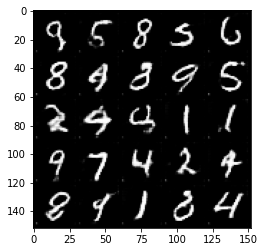

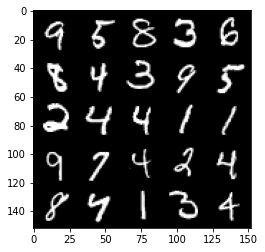

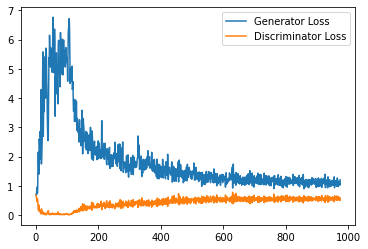

Step 20000: Generator loss: 1.1032350821495056, discriminator loss: 0.5664536126852036


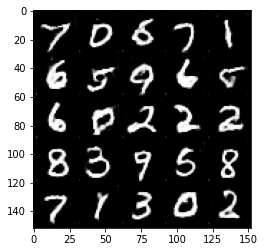

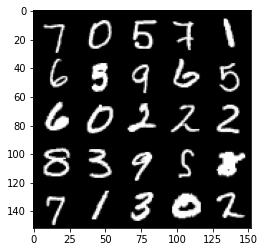

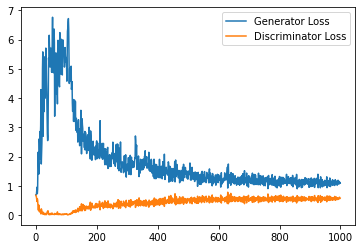

Step 20500: Generator loss: 1.0755863791704179, discriminator loss: 0.5680150142908096


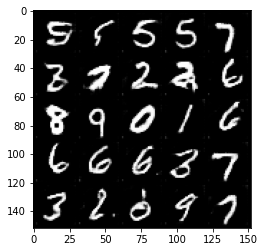

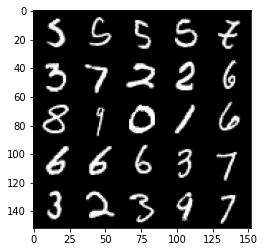

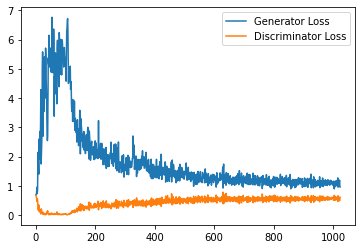

Step 21000: Generator loss: 1.069413018465042, discriminator loss: 0.5677553205490112


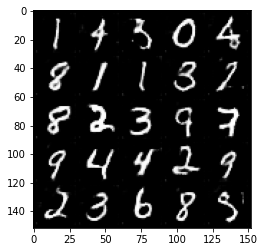

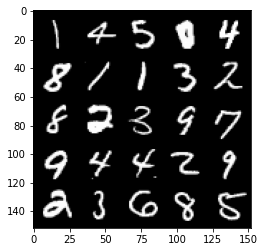

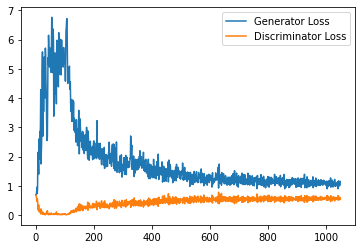

Step 21500: Generator loss: 1.0774735610485078, discriminator loss: 0.5664512078166009


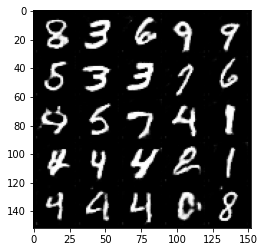

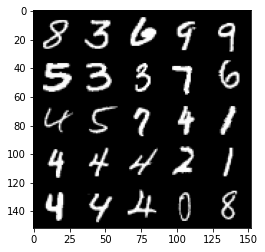

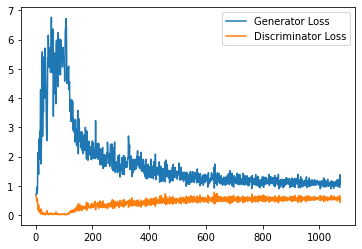

Step 22000: Generator loss: 1.0705775010585785, discriminator loss: 0.5682574950456619


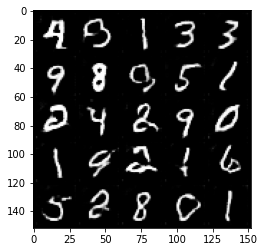

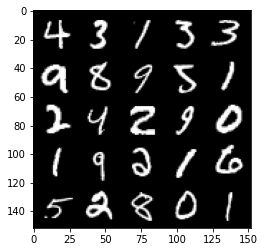

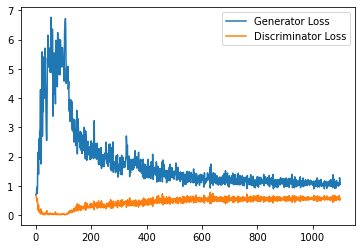

Step 22500: Generator loss: 1.073486359000206, discriminator loss: 0.5777566365003586


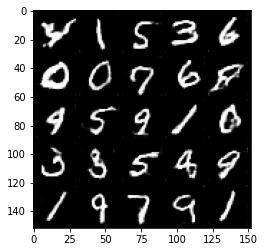

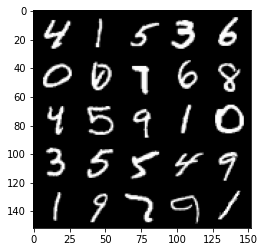

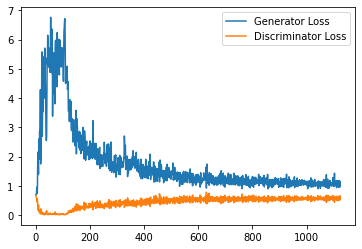

Step 23000: Generator loss: 1.0575294443368912, discriminator loss: 0.5774174317717552


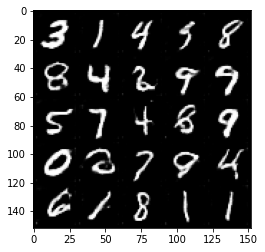

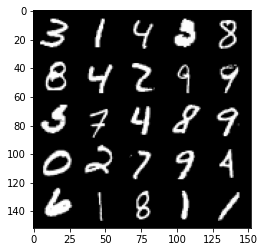

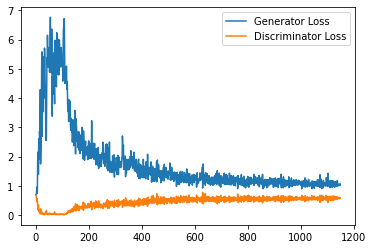

Step 23500: Generator loss: 1.0636327039003373, discriminator loss: 0.5798798263669014


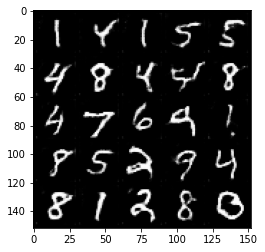

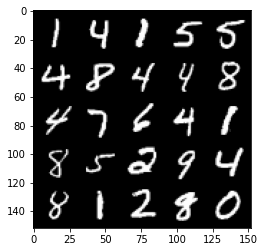

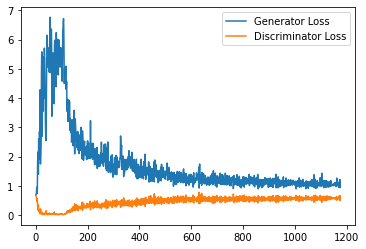

Step 24000: Generator loss: 1.0596495251655578, discriminator loss: 0.5821884765625


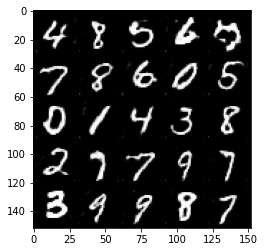

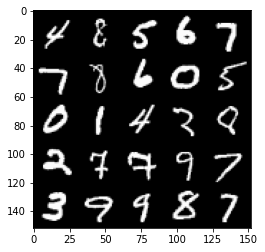

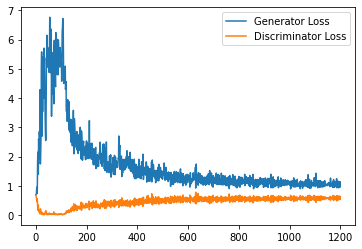

Step 24500: Generator loss: 1.0197416644096375, discriminator loss: 0.5883962792754174


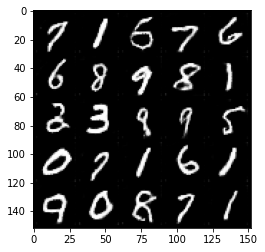

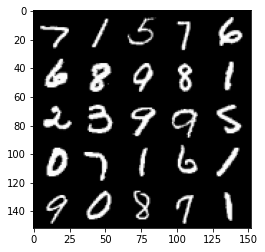

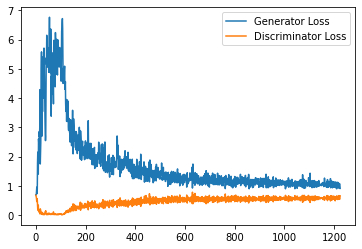

Step 25000: Generator loss: 1.0362853516340256, discriminator loss: 0.5863456553220749


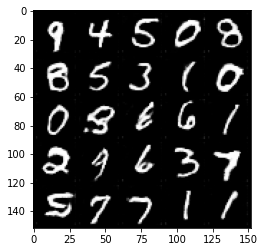

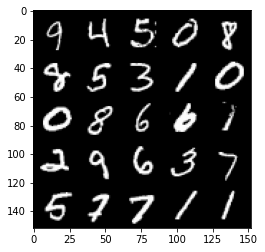

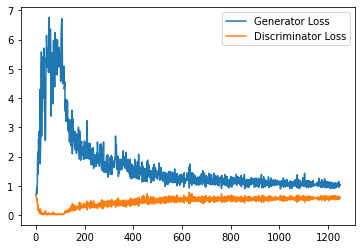

Step 25500: Generator loss: 1.0629892445802689, discriminator loss: 0.5834167682528496


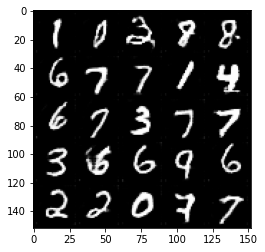

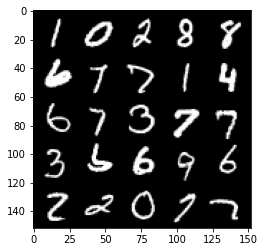

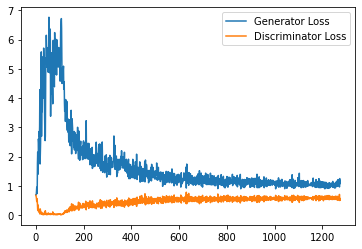

Step 26000: Generator loss: 1.0324641790390015, discriminator loss: 0.5952701374292374


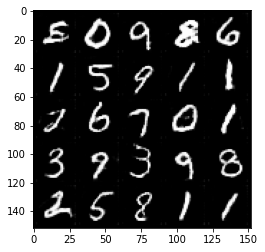

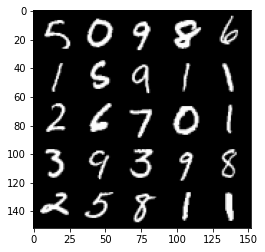

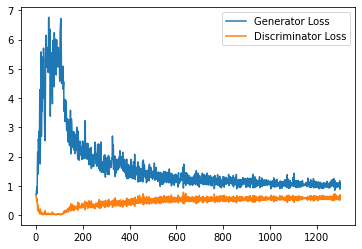

Step 26500: Generator loss: 1.0069269870519637, discriminator loss: 0.5907466799020767


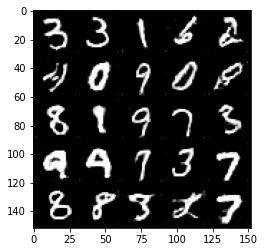

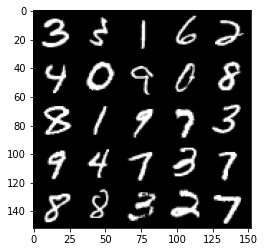

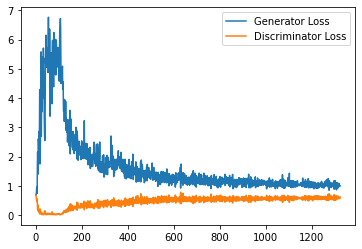

Step 27000: Generator loss: 1.0398084667921066, discriminator loss: 0.5889062529802322


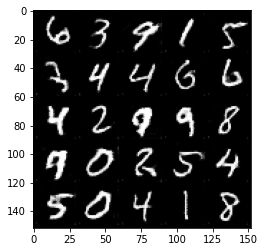

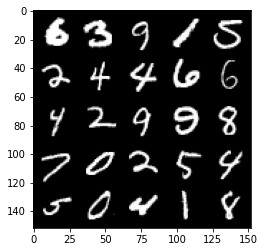

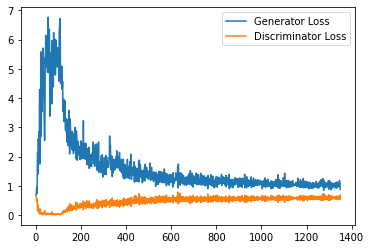

Step 27500: Generator loss: 1.023002435207367, discriminator loss: 0.5895466675758362


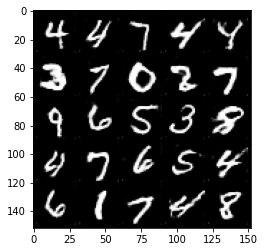

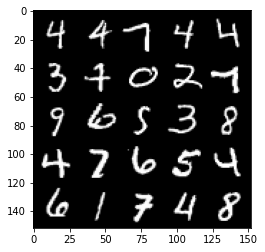

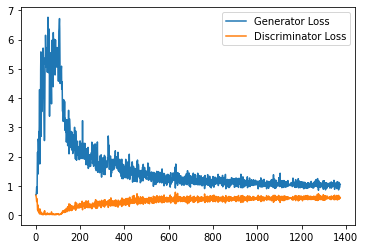

Step 28000: Generator loss: 1.0235573068857193, discriminator loss: 0.5874210585951805


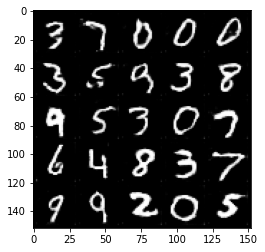

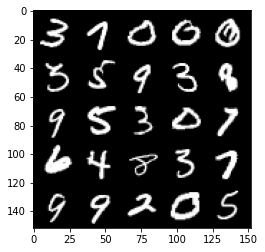

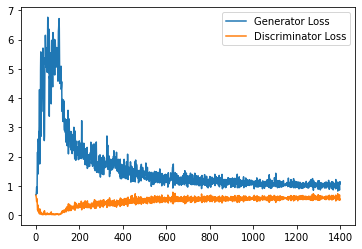

Step 28500: Generator loss: 1.018709937095642, discriminator loss: 0.5931892949342727


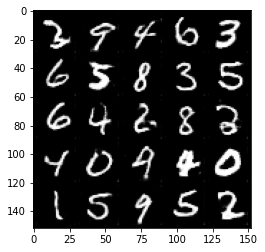

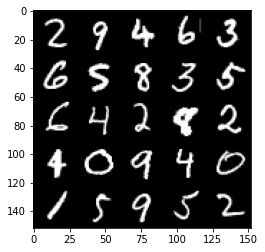

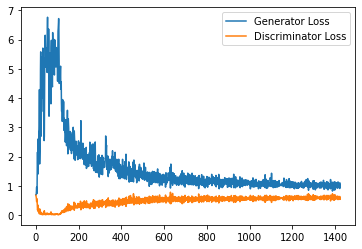

Step 29000: Generator loss: 1.0198606836795807, discriminator loss: 0.5944393771886826


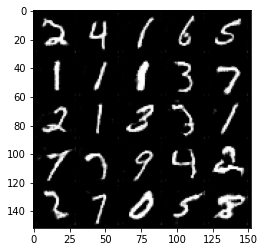

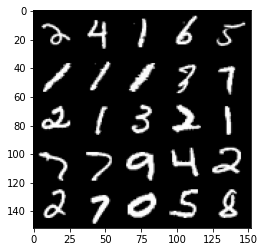

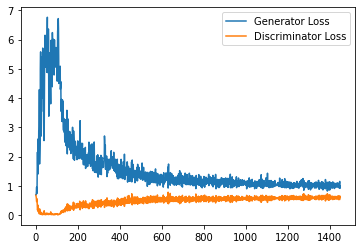

Step 29500: Generator loss: 1.027115311741829, discriminator loss: 0.5923016285300254


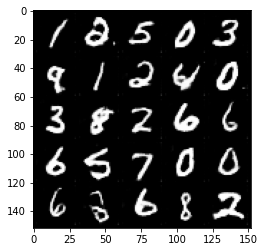

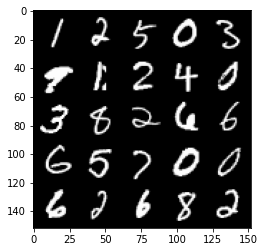

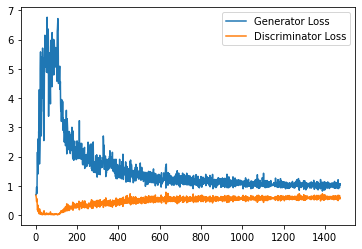

Step 30000: Generator loss: 1.0006065655946732, discriminator loss: 0.6022374060750008


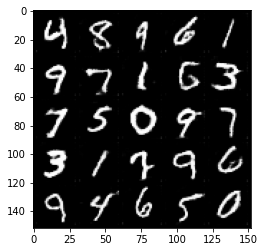

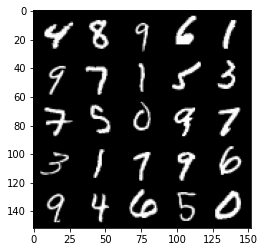

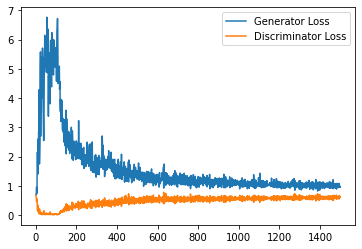

Step 30500: Generator loss: 1.0223845440149306, discriminator loss: 0.5920246222615242


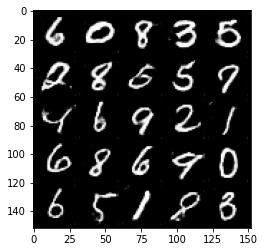

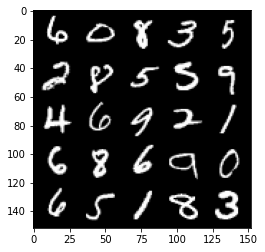

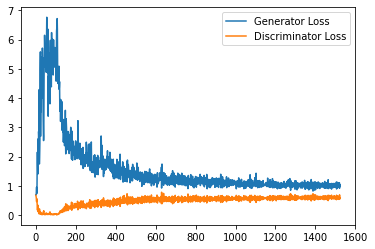

Step 31000: Generator loss: 1.037181701540947, discriminator loss: 0.5897738286256791


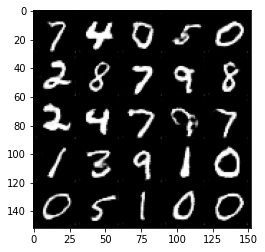

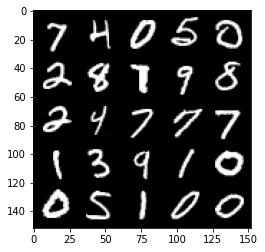

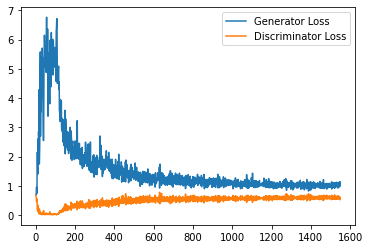

Step 31500: Generator loss: 1.0155722286701203, discriminator loss: 0.5997741417884827


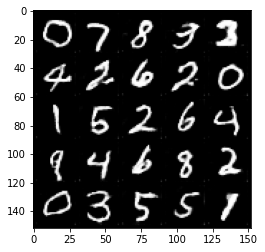

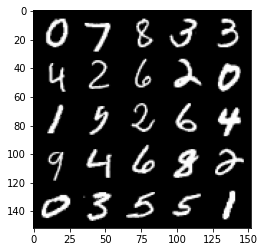

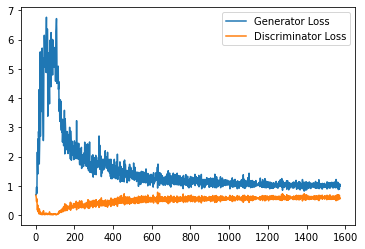

Step 32000: Generator loss: 0.9890469274520874, discriminator loss: 0.5963867484927178


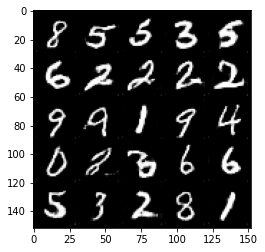

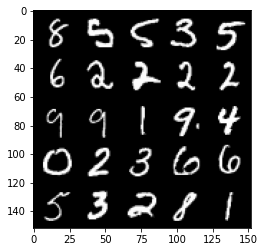

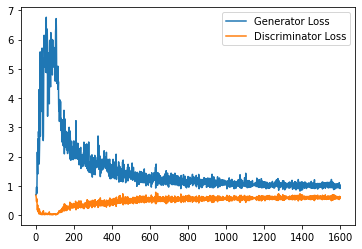

Step 32500: Generator loss: 1.0319268138408662, discriminator loss: 0.6007617750167846


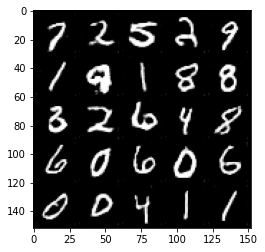

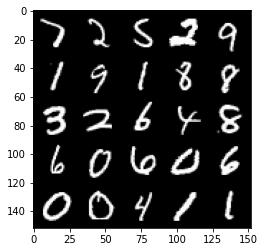

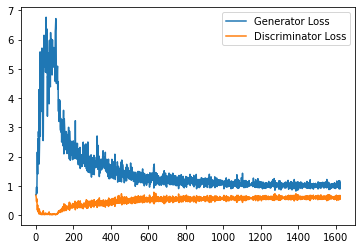

Step 33000: Generator loss: 1.0206611367464065, discriminator loss: 0.5969059802293778


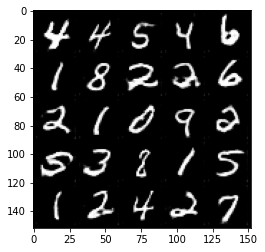

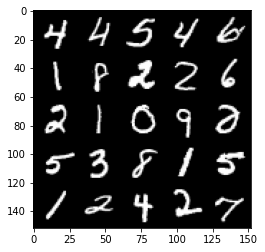

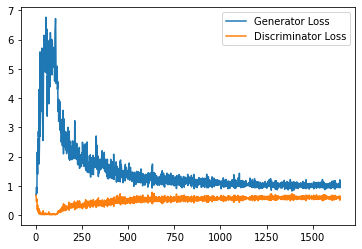

Step 33500: Generator loss: 1.0217931934595108, discriminator loss: 0.5929075489640236


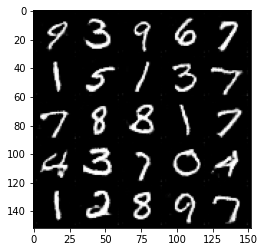

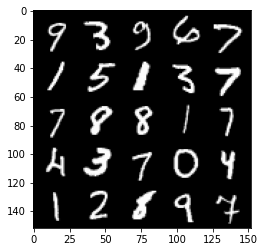

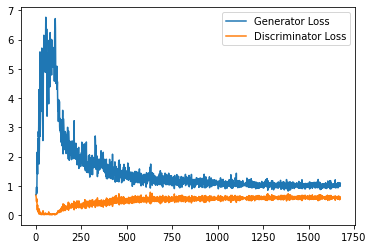

Step 34000: Generator loss: 1.010554166674614, discriminator loss: 0.6019413347840309


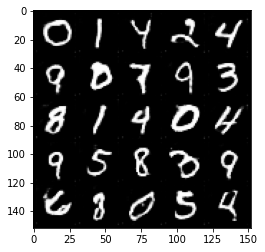

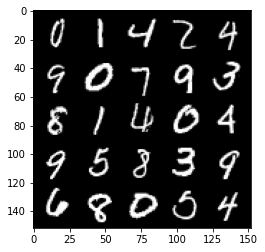

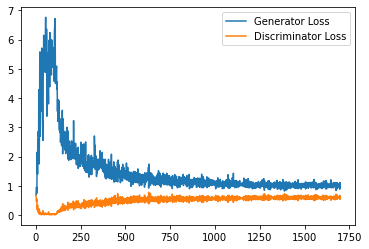

Step 34500: Generator loss: 1.0173433660268782, discriminator loss: 0.5929775953292846


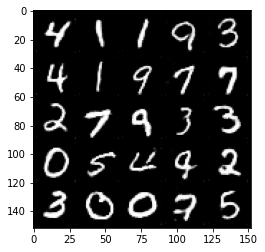

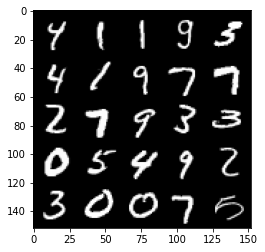

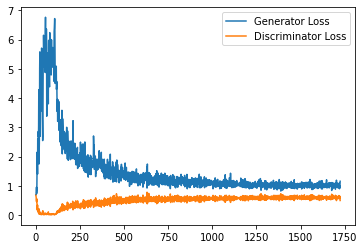

Step 35000: Generator loss: 1.0111472710371017, discriminator loss: 0.6005491923093795


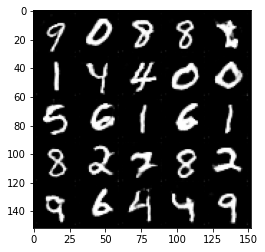

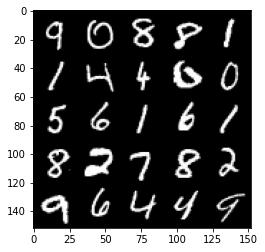

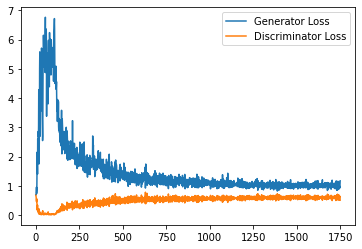

Step 35500: Generator loss: 0.987666774392128, discriminator loss: 0.6034400763511658


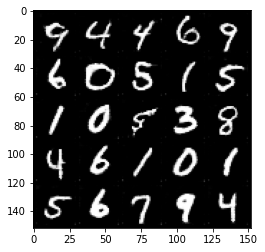

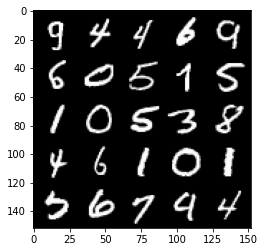

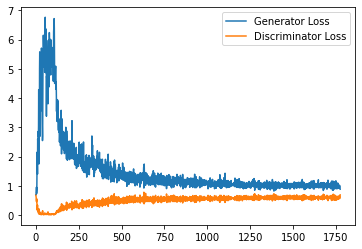

Step 36000: Generator loss: 1.0032644004821778, discriminator loss: 0.5943465156555175


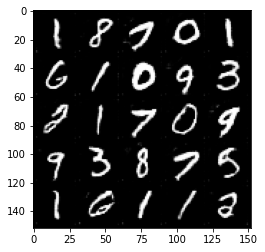

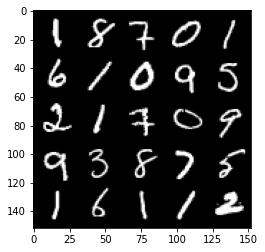

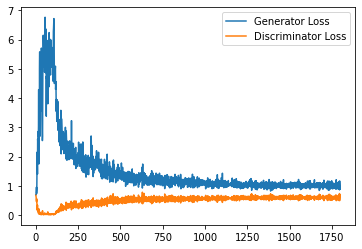

Step 36500: Generator loss: 1.0344420518875121, discriminator loss: 0.5970198094844819


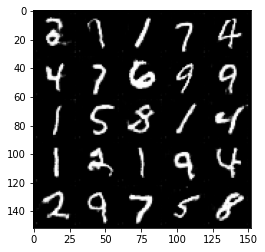

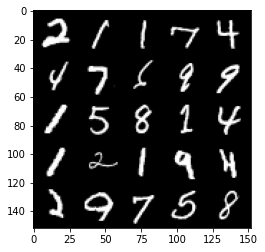

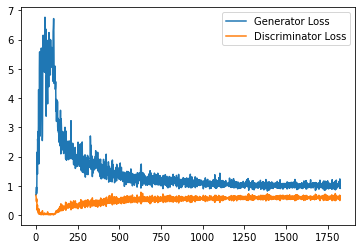

Step 37000: Generator loss: 1.0221199156045915, discriminator loss: 0.5958281340003013


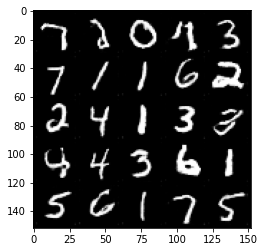

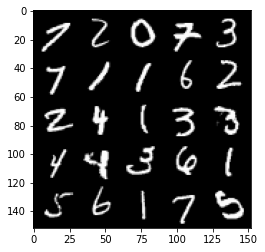

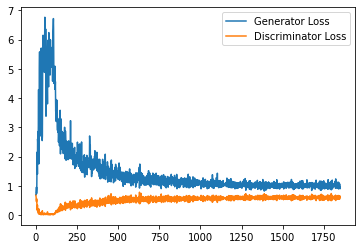

Step 37500: Generator loss: 0.9768176701068878, discriminator loss: 0.601286403477192


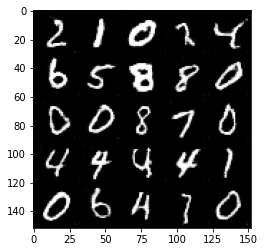

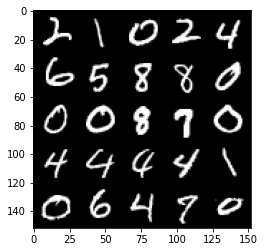

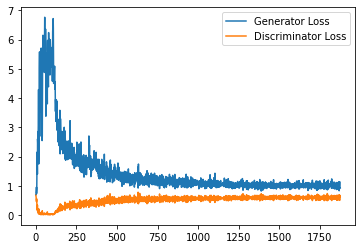

Step 38000: Generator loss: 1.0091182347536087, discriminator loss: 0.5929276221990585


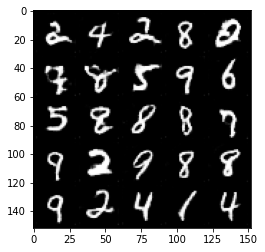

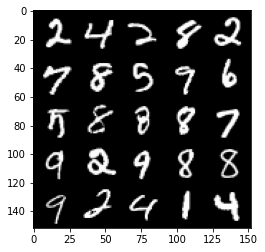

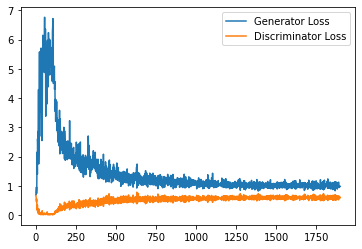

Step 38500: Generator loss: 1.015331218957901, discriminator loss: 0.6001257362365723


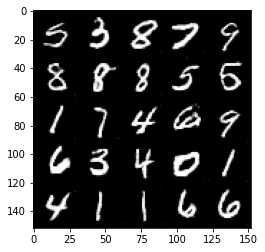

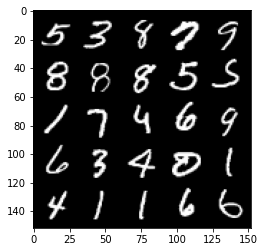

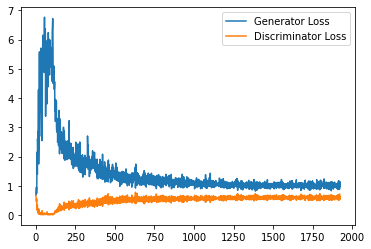

Step 39000: Generator loss: 1.0255573298931122, discriminator loss: 0.5913867241144181


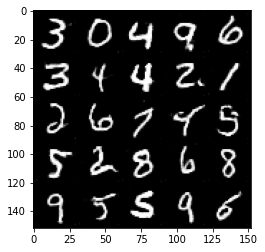

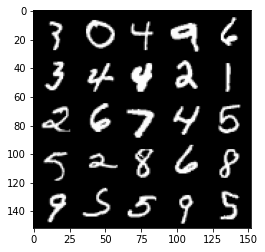

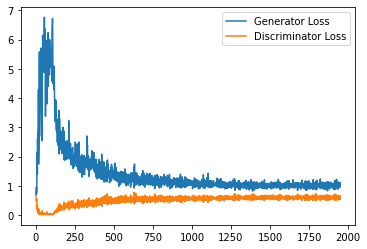

Step 39500: Generator loss: 1.0195015780925751, discriminator loss: 0.592093186378479


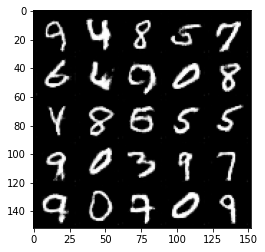

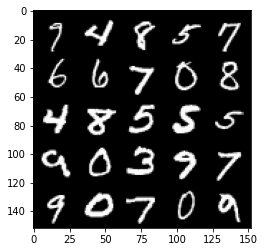

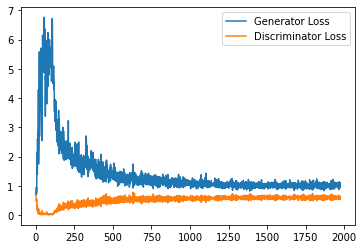

Step 40000: Generator loss: 1.0421251183748246, discriminator loss: 0.5882694284319878


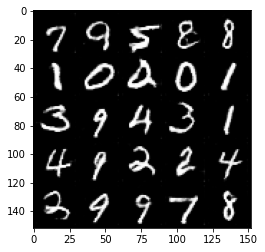

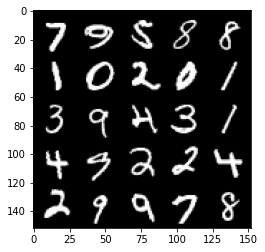

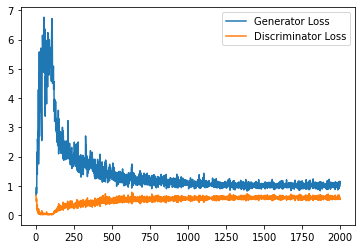

Step 40500: Generator loss: 1.027908628821373, discriminator loss: 0.5978813813328743


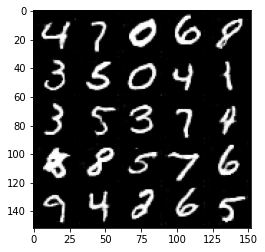

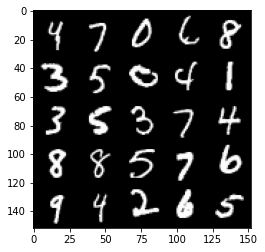

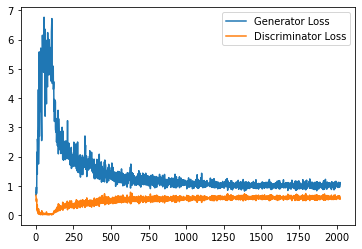

Step 41000: Generator loss: 0.9948884352445603, discriminator loss: 0.5998071737885475


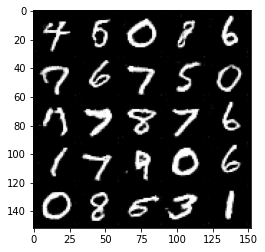

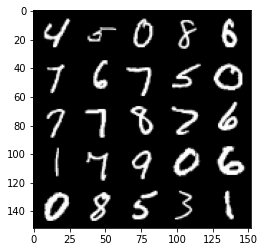

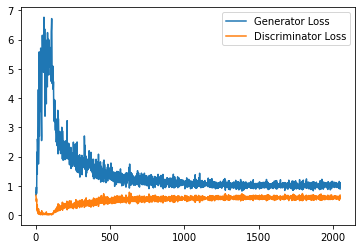

Step 41500: Generator loss: 1.0232720819711685, discriminator loss: 0.5923225662708282


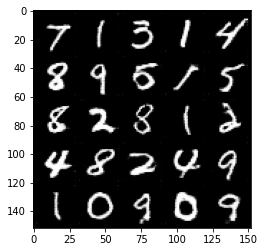

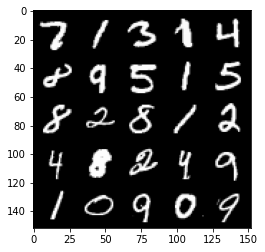

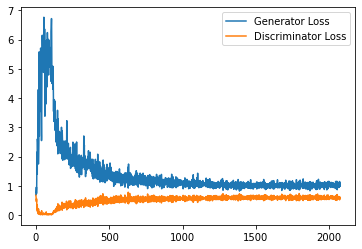

Step 42000: Generator loss: 1.0588605486154556, discriminator loss: 0.5915926081538201


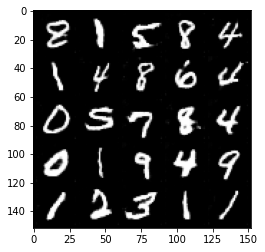

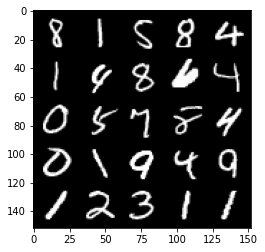

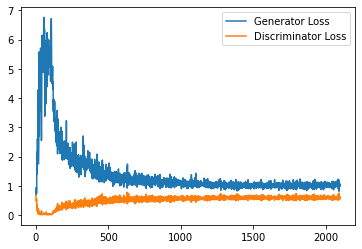

Step 42500: Generator loss: 1.0120845021009446, discriminator loss: 0.5968282905817032


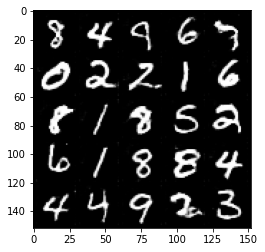

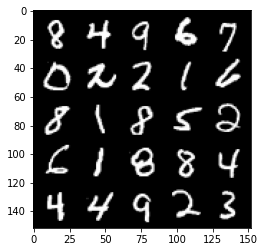

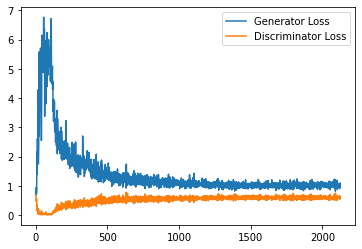

Step 43000: Generator loss: 0.9970989218950271, discriminator loss: 0.5955578733086586


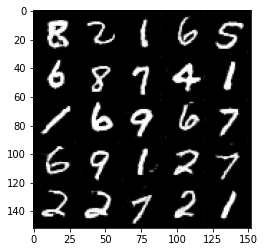

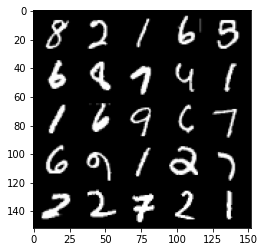

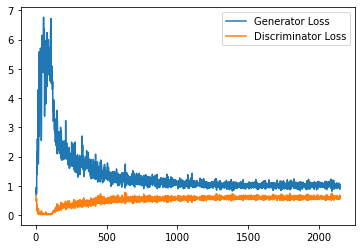

Step 43500: Generator loss: 1.024800569653511, discriminator loss: 0.5929095129966736


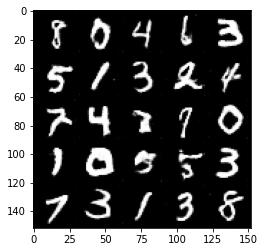

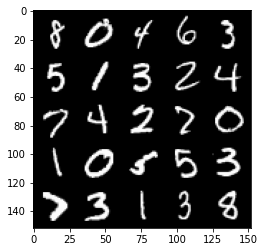

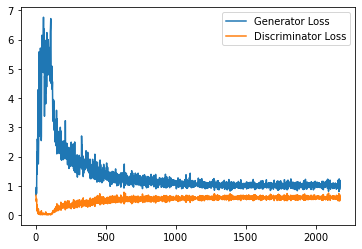

Step 44000: Generator loss: 1.0077187889814376, discriminator loss: 0.5968019419908523


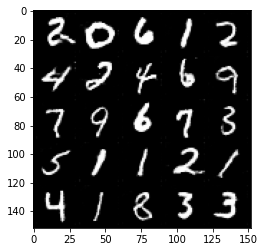

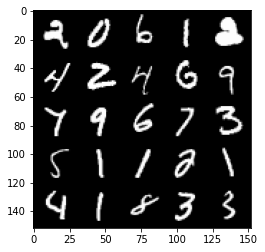

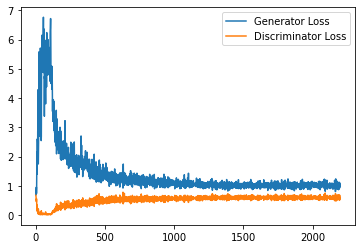

Step 44500: Generator loss: 0.9889470518827438, discriminator loss: 0.5978048848509788


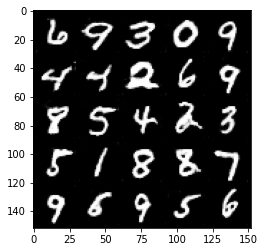

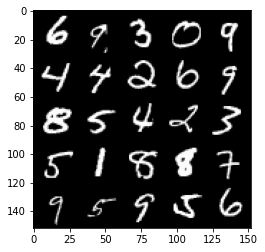

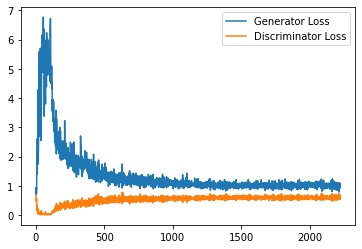

Step 45000: Generator loss: 0.9995472815036773, discriminator loss: 0.5896971695423127


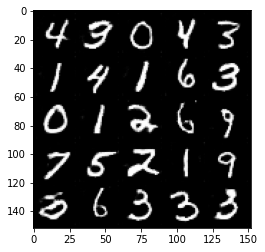

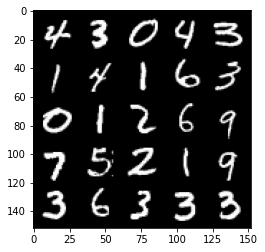

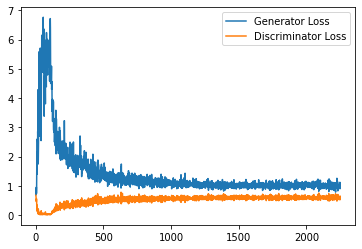

Step 45500: Generator loss: 1.0220119624137878, discriminator loss: 0.5916582239866257


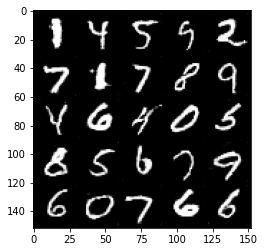

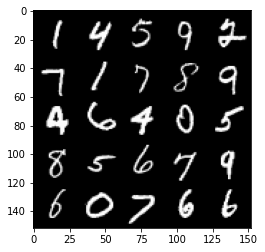

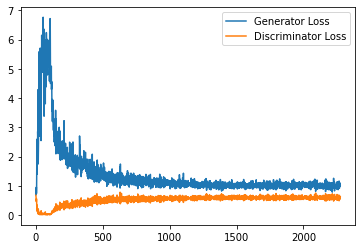

Step 46000: Generator loss: 1.0423665248155594, discriminator loss: 0.6014865075349808


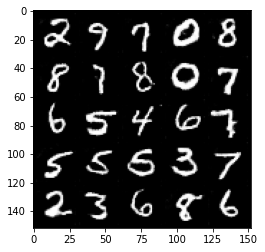

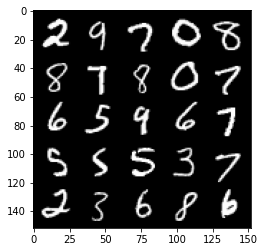

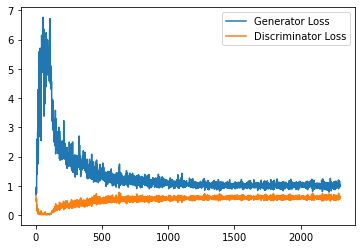

Step 46500: Generator loss: 1.0034501842260362, discriminator loss: 0.6058737056255341


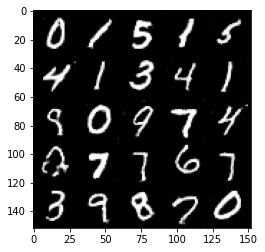

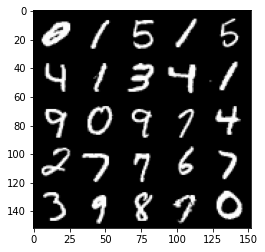

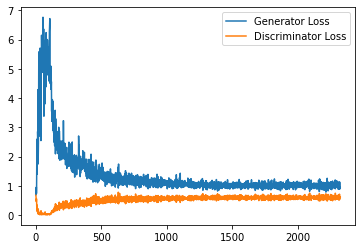

Step 47000: Generator loss: 0.9904589787721634, discriminator loss: 0.5887048231959343


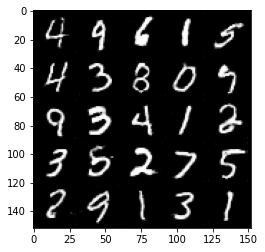

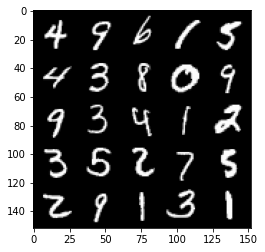

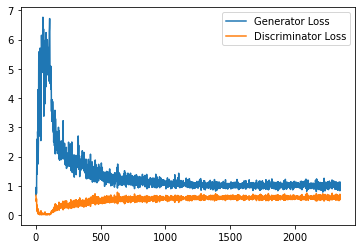

Step 47500: Generator loss: 1.007641763806343, discriminator loss: 0.5947106318473816


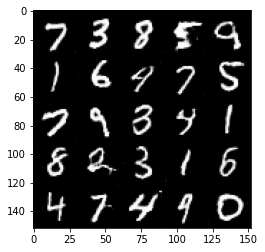

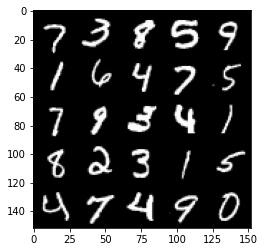

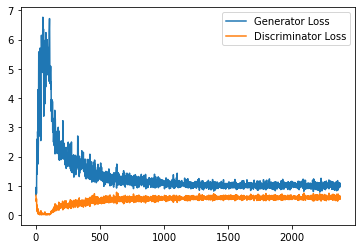

Step 48000: Generator loss: 1.0468492302894592, discriminator loss: 0.5949580473303795


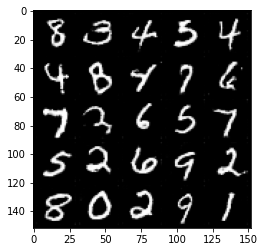

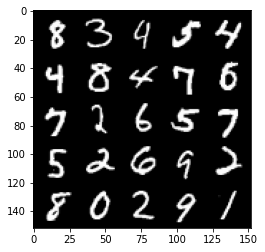

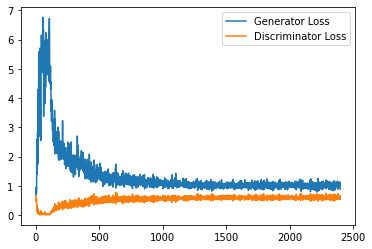

Step 48500: Generator loss: 1.0096926615238189, discriminator loss: 0.5915041018724442


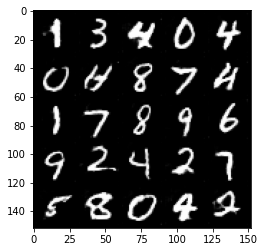

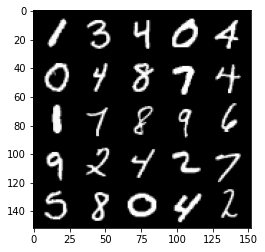

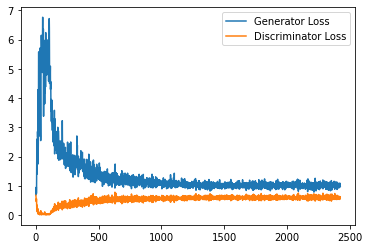

Step 49000: Generator loss: 1.010775969028473, discriminator loss: 0.5851721258163453


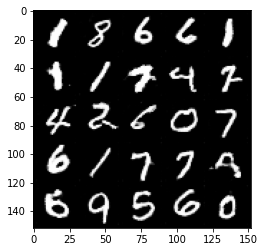

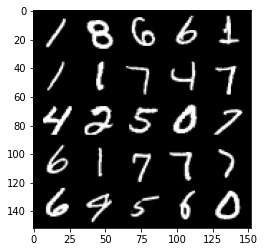

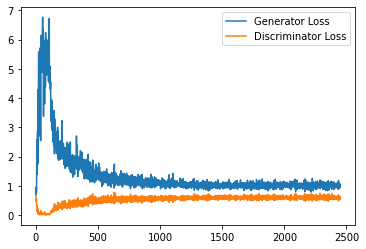

Step 49500: Generator loss: 1.007987049818039, discriminator loss: 0.5855568670630455


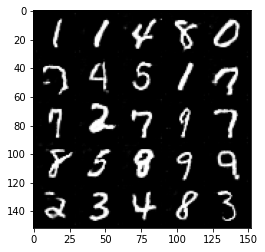

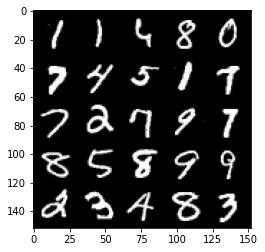

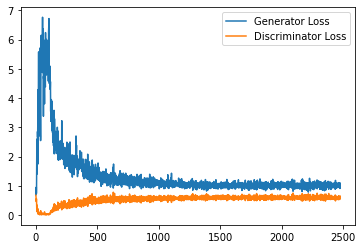

Step 50000: Generator loss: 1.0270175997018813, discriminator loss: 0.5833837895393371


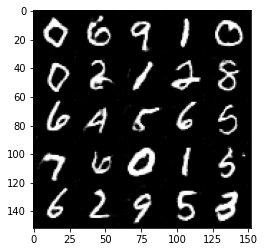

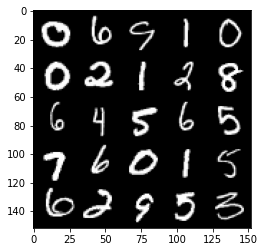

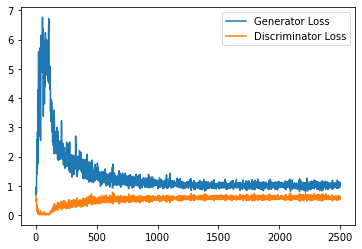

Step 50500: Generator loss: 1.032305678963661, discriminator loss: 0.5880278036594391


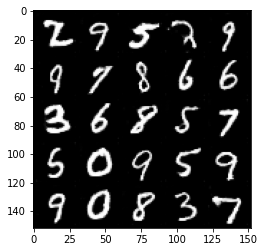

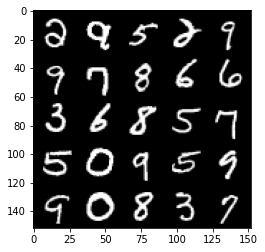

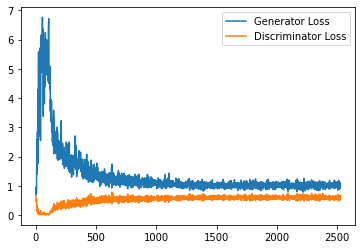

Step 51000: Generator loss: 1.026599859714508, discriminator loss: 0.5834771064519882


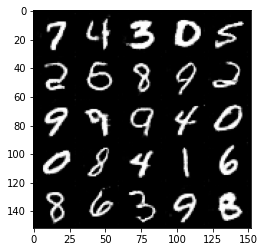

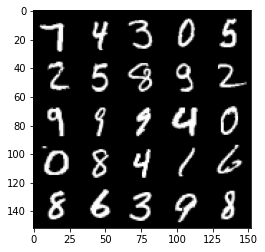

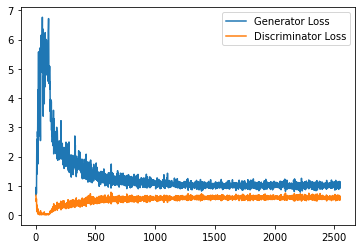

Step 51500: Generator loss: 1.0213769360780716, discriminator loss: 0.5928343282938003


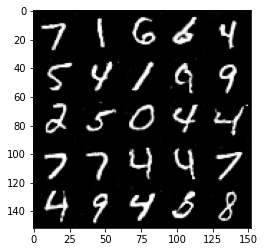

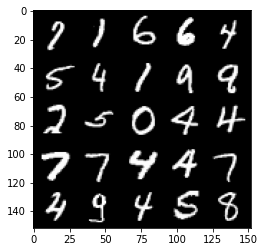

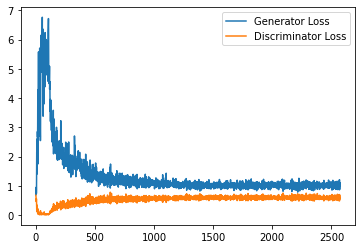

Step 52000: Generator loss: 1.0243574088811875, discriminator loss: 0.5900151287913322


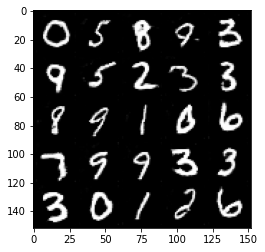

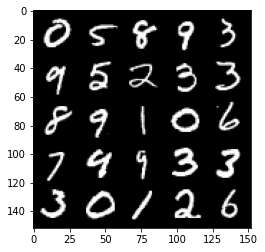

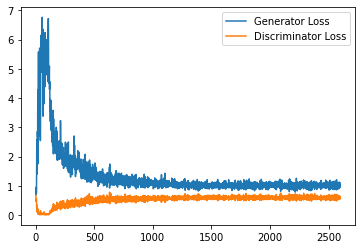

Step 52500: Generator loss: 1.02502998483181, discriminator loss: 0.5844107801318169


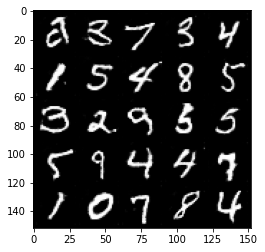

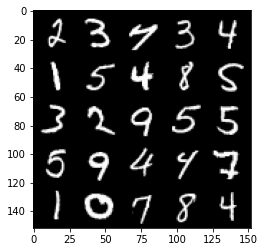

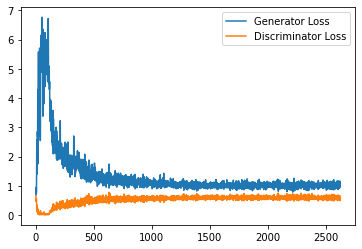

Step 53000: Generator loss: 1.03559452354908, discriminator loss: 0.5834583696126938


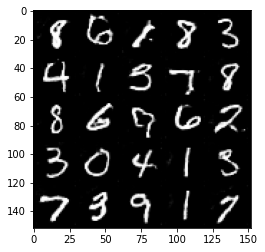

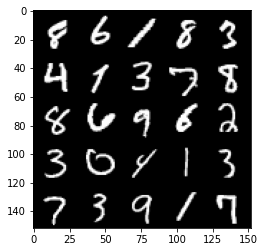

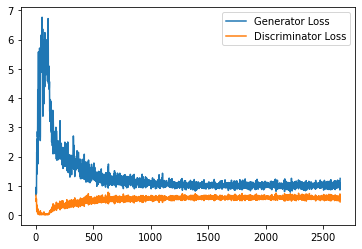

Step 53500: Generator loss: 1.0393079787492752, discriminator loss: 0.5849538351893425


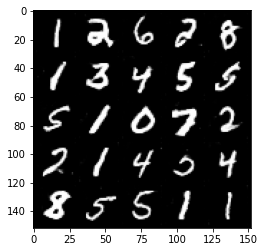

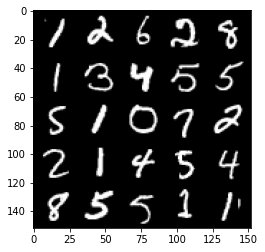

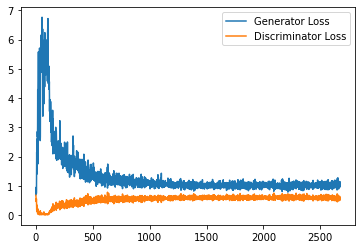

Step 54000: Generator loss: 1.0127259101867676, discriminator loss: 0.5899316487908364


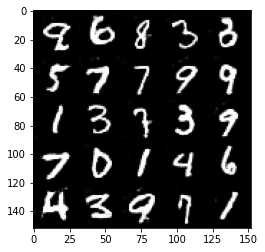

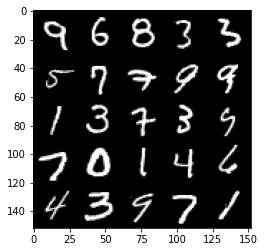

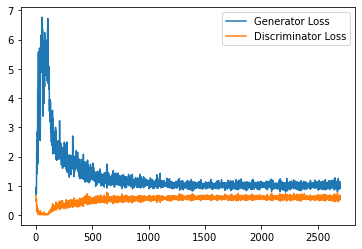

Step 54500: Generator loss: 1.0222593766450883, discriminator loss: 0.5746970306634903


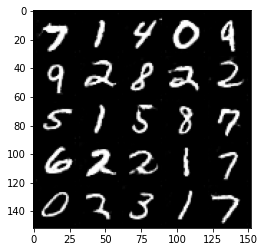

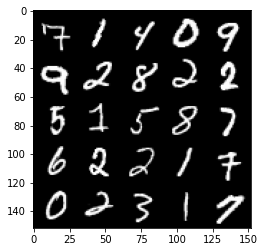

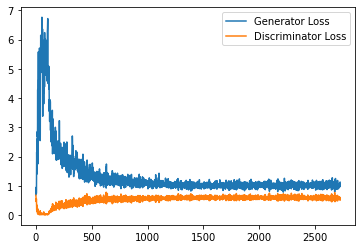

Step 55000: Generator loss: 1.0531222357749939, discriminator loss: 0.5801201087236404


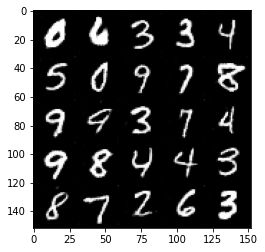

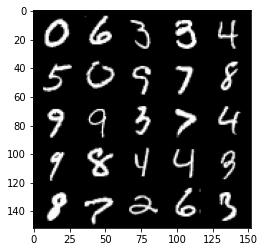

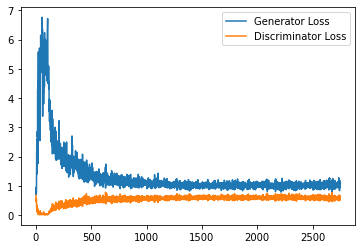

Step 55500: Generator loss: 1.0380085911750794, discriminator loss: 0.5795436446666717


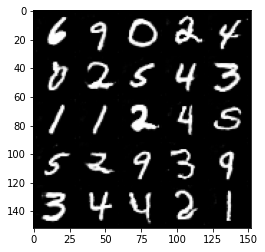

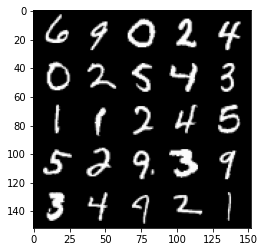

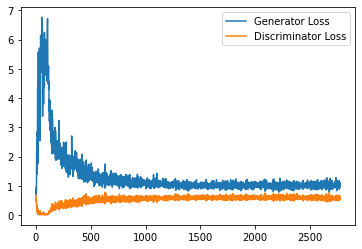

Step 56000: Generator loss: 1.0327517278194427, discriminator loss: 0.5810711712837219


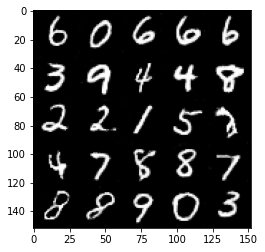

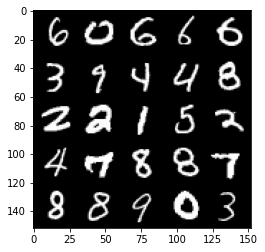

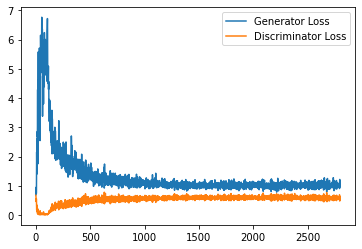

Step 56500: Generator loss: 1.0425153241157532, discriminator loss: 0.585318601667881


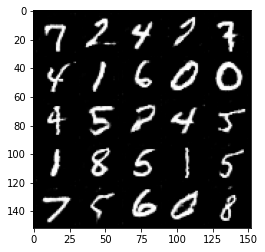

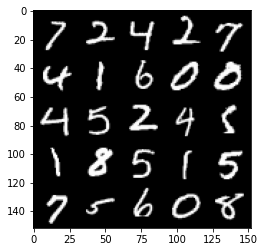

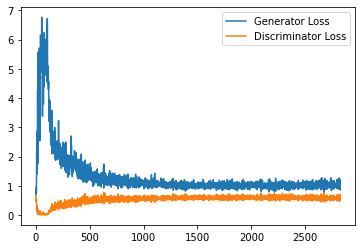

Step 57000: Generator loss: 1.0443602687120437, discriminator loss: 0.5806382465958595


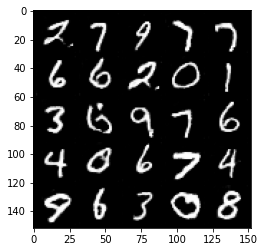

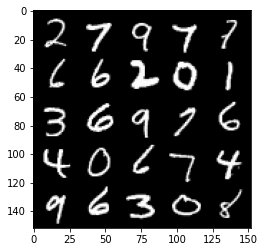

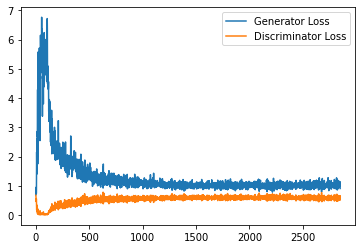

Step 57500: Generator loss: 1.0291011428833008, discriminator loss: 0.580396780371666


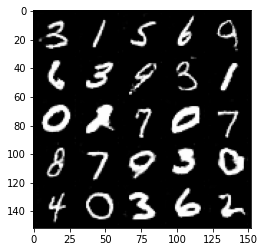

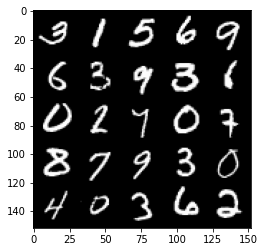

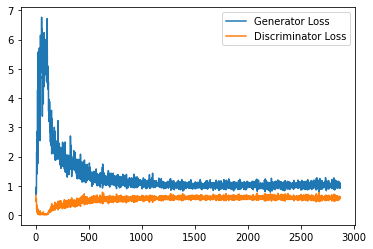

Step 58000: Generator loss: 1.0269641836881638, discriminator loss: 0.578562439441681


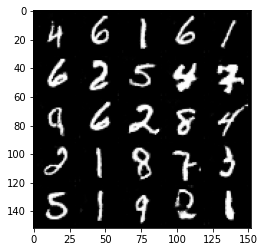

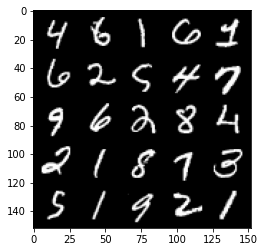

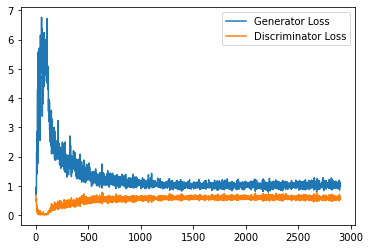

Step 58500: Generator loss: 1.0443047243356705, discriminator loss: 0.5845425326228142


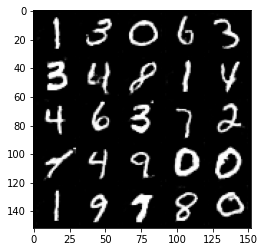

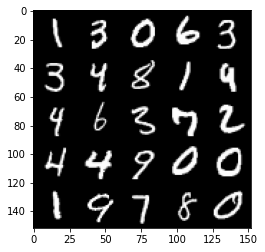

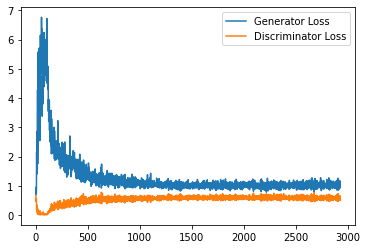

Step 59000: Generator loss: 1.0485740523338318, discriminator loss: 0.5771523159742356


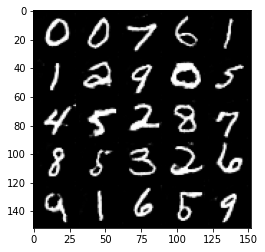

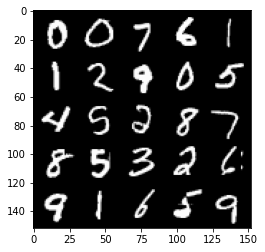

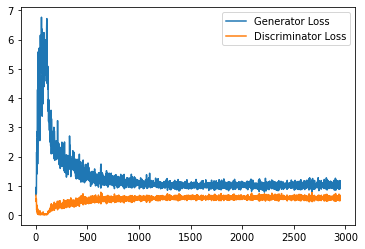

Step 59500: Generator loss: 1.0307897272109985, discriminator loss: 0.5832774153947831


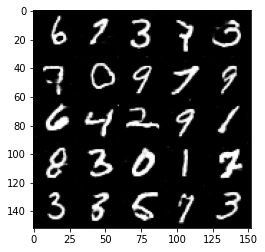

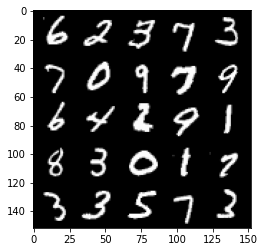

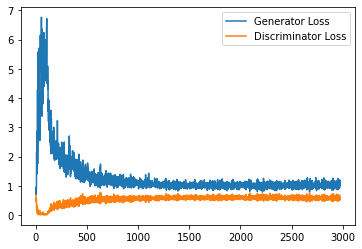

Step 60000: Generator loss: 1.02890100979805, discriminator loss: 0.5826706335544586


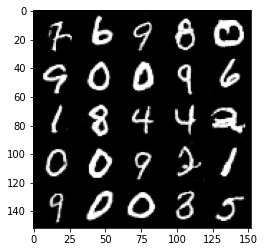

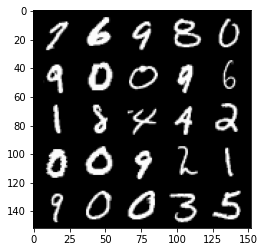

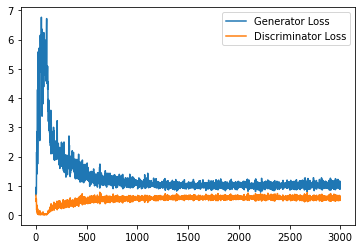

Step 60500: Generator loss: 1.0212227836847305, discriminator loss: 0.5832850058674812


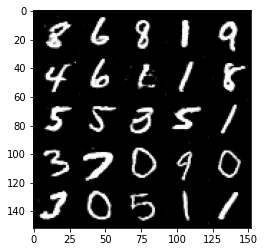

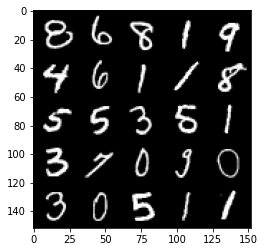

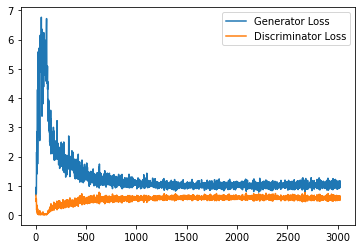

Step 61000: Generator loss: 1.0435904948711394, discriminator loss: 0.5775814926624299


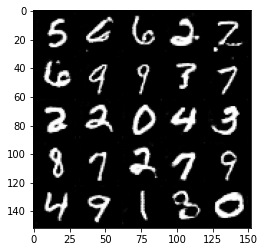

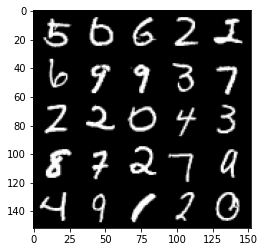

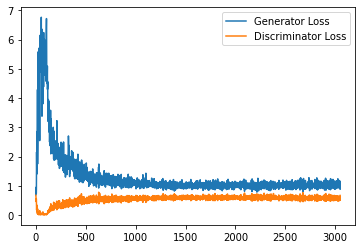

Step 61500: Generator loss: 1.033256759762764, discriminator loss: 0.5786008149981499


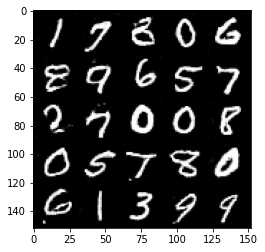

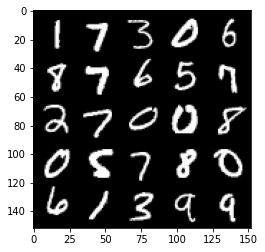

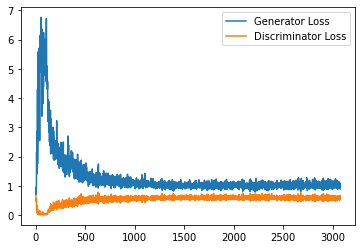

Step 62000: Generator loss: 1.0425734894275664, discriminator loss: 0.5737006468176842


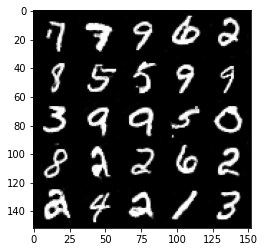

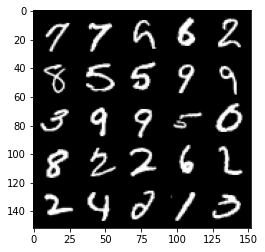

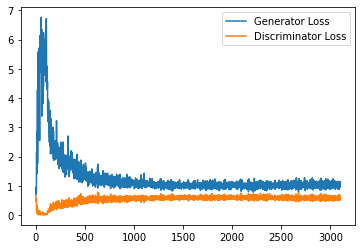

Step 62500: Generator loss: 1.0298324275016784, discriminator loss: 0.5743331332206726


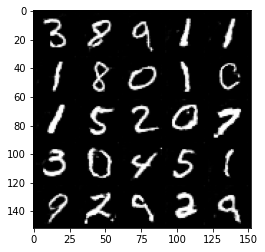

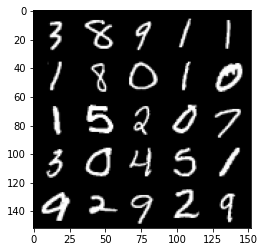

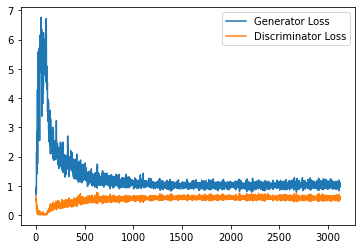

Step 63000: Generator loss: 1.0444745944738387, discriminator loss: 0.5850083023309708


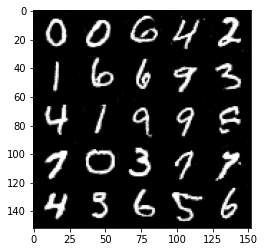

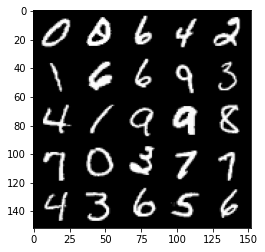

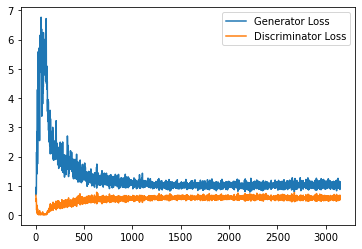

Step 63500: Generator loss: 1.0483454794883729, discriminator loss: 0.5785070879459381


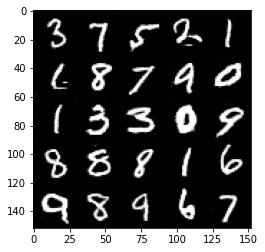

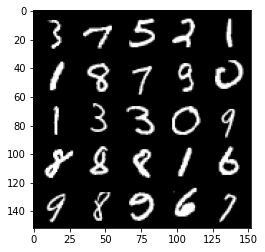

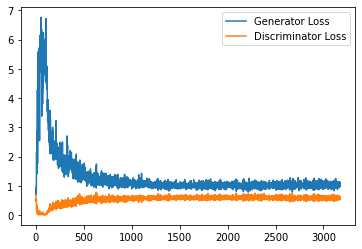

Step 64000: Generator loss: 1.069364067673683, discriminator loss: 0.573006852388382


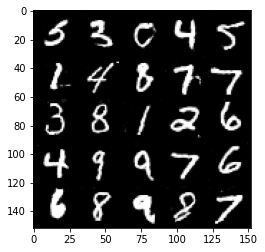

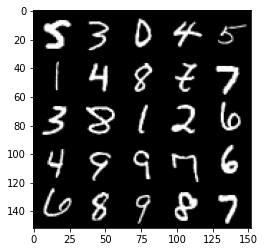

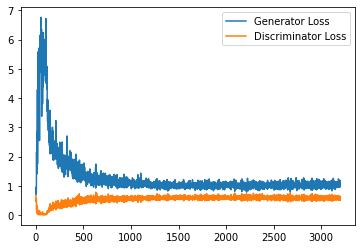

Step 64500: Generator loss: 1.0538668016195296, discriminator loss: 0.5816221884489059


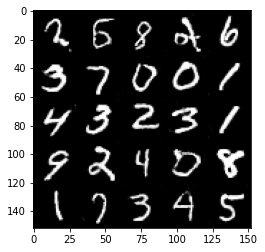

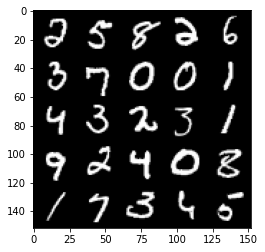

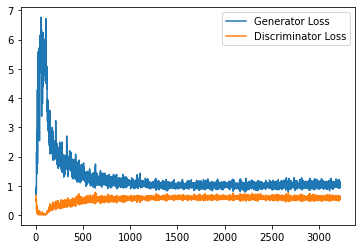

Step 65000: Generator loss: 1.0318778178691863, discriminator loss: 0.5791065535545349


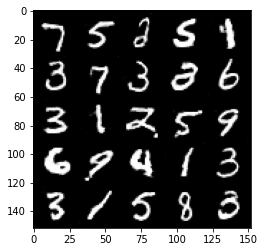

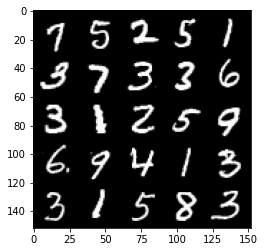

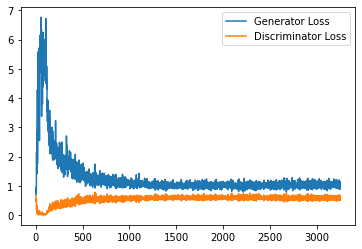

Step 65500: Generator loss: 1.038883218050003, discriminator loss: 0.577945087134838


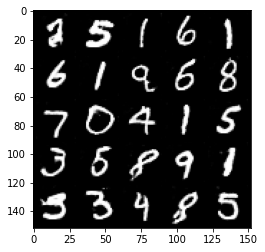

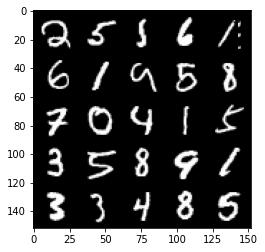

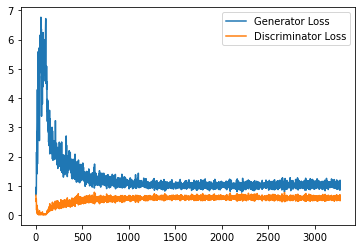

Step 66000: Generator loss: 1.029220851421356, discriminator loss: 0.5807320674061776


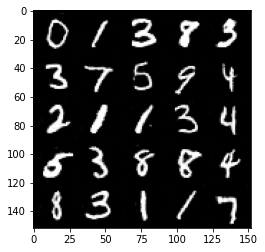

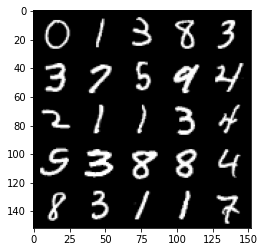

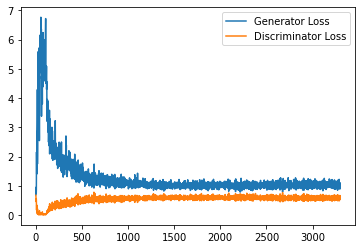

Step 66500: Generator loss: 1.0481990505456924, discriminator loss: 0.5769290941953659


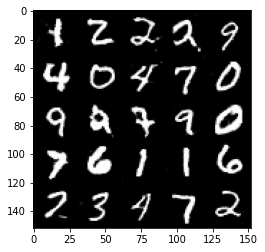

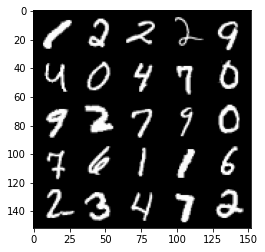

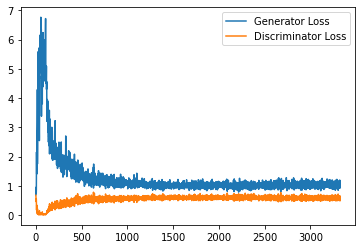

Step 67000: Generator loss: 1.0591836041212082, discriminator loss: 0.5783462836742401


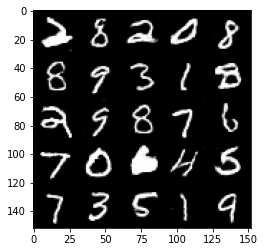

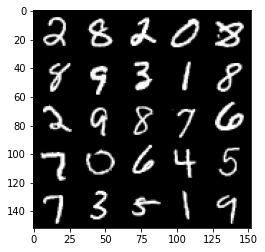

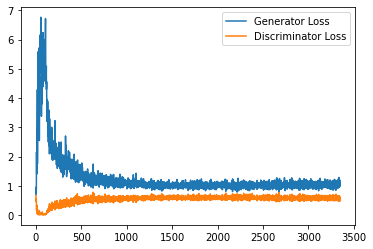

Step 67500: Generator loss: 1.0306215952634812, discriminator loss: 0.5803123258948326


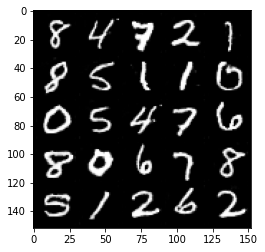

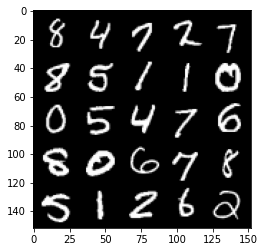

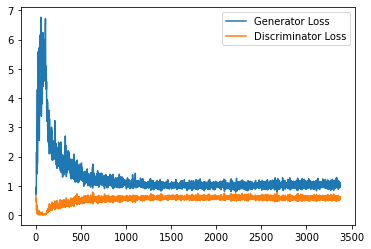

Step 68000: Generator loss: 1.0488749457597732, discriminator loss: 0.574711632668972


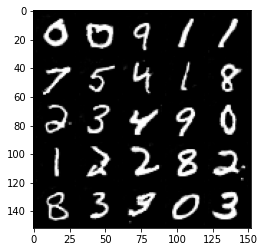

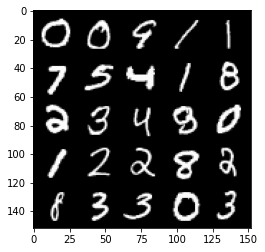

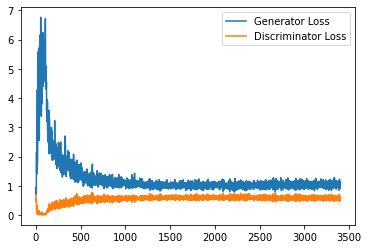

Step 68500: Generator loss: 1.024502856016159, discriminator loss: 0.5822225660085678


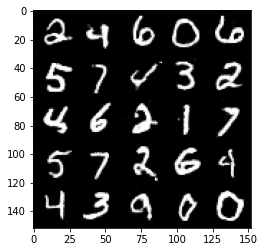

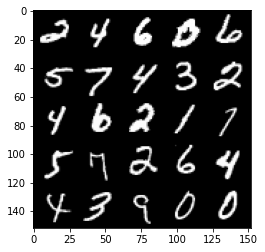

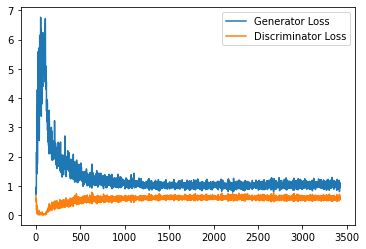

Step 69000: Generator loss: 1.050259175658226, discriminator loss: 0.58215451669693


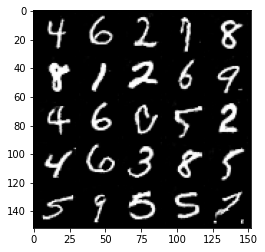

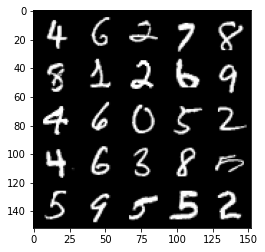

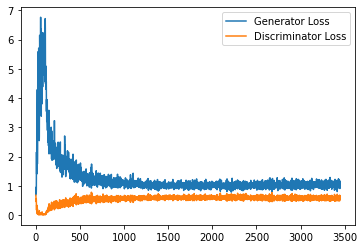

Step 69500: Generator loss: 1.0319356548786163, discriminator loss: 0.578586442887783


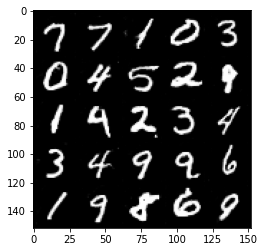

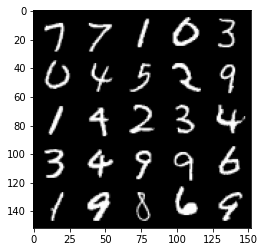

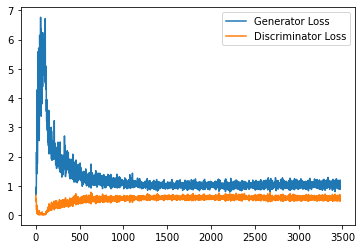

Step 70000: Generator loss: 1.0382756834030151, discriminator loss: 0.584915107011795


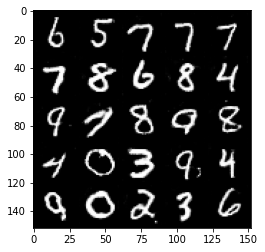

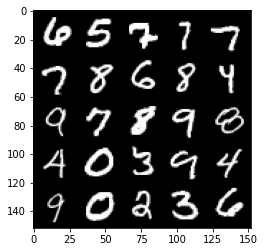

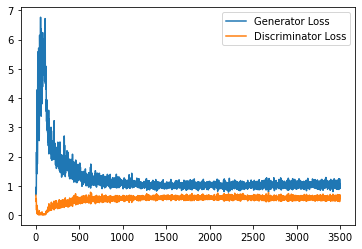

Step 70500: Generator loss: 1.037408126950264, discriminator loss: 0.5772913884520531


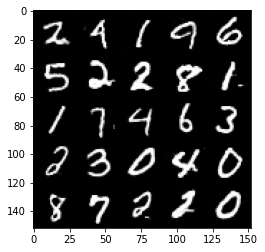

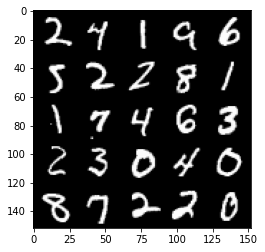

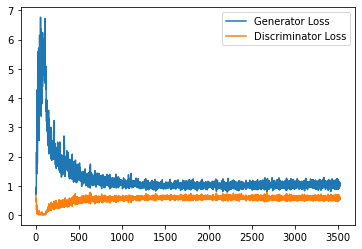

Step 71000: Generator loss: 1.0480459220409393, discriminator loss: 0.5806018303632736


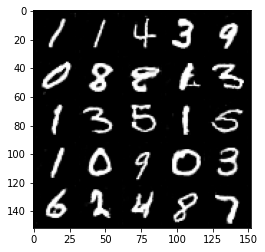

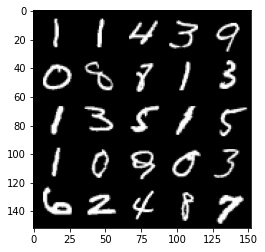

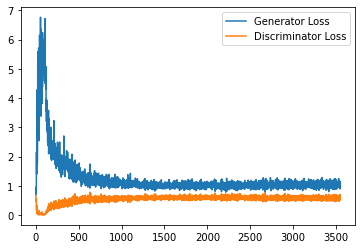

Step 71500: Generator loss: 1.031140796661377, discriminator loss: 0.5798781083226204


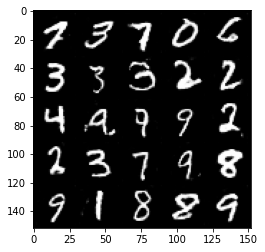

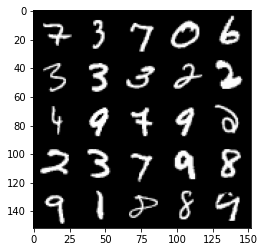

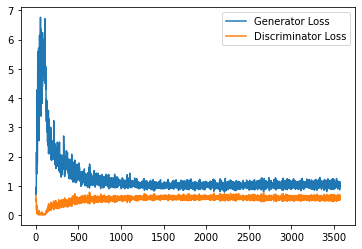

Step 72000: Generator loss: 1.0405029956102372, discriminator loss: 0.5864646163582802


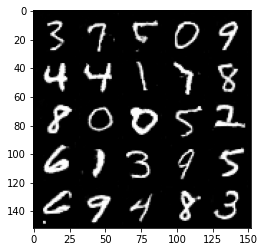

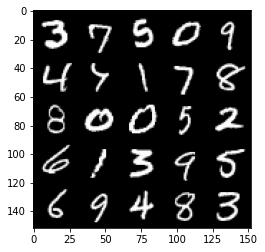

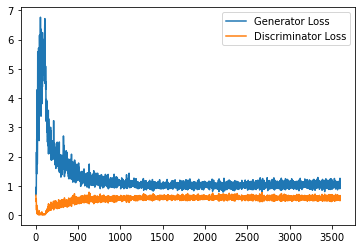

Step 72500: Generator loss: 1.0346724022626876, discriminator loss: 0.5775843894481659


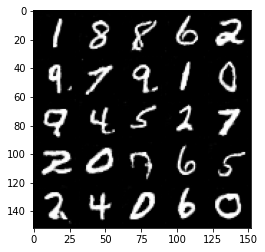

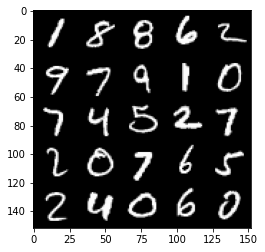

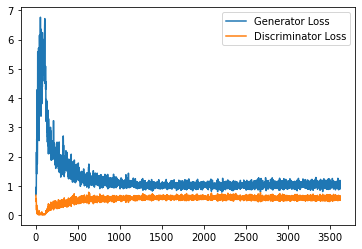

Step 73000: Generator loss: 1.0492430238723756, discriminator loss: 0.585515025138855


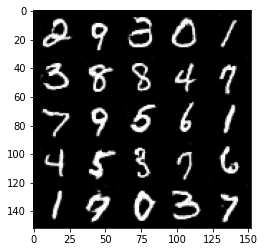

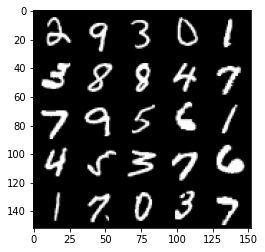

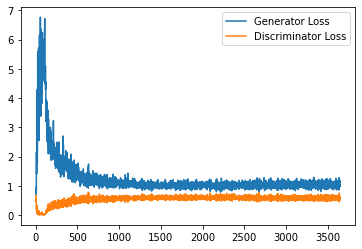

Step 73500: Generator loss: 1.0475645501613617, discriminator loss: 0.5826323910355568


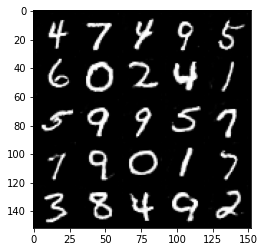

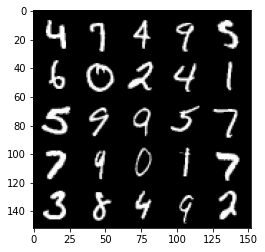

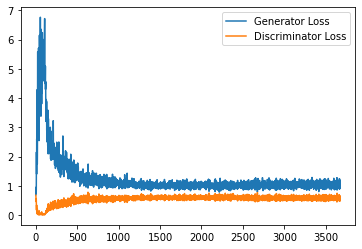

Step 74000: Generator loss: 1.0227815424203872, discriminator loss: 0.5799665549397468


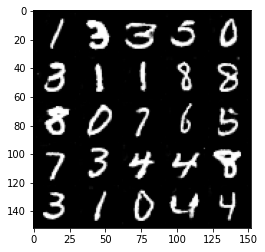

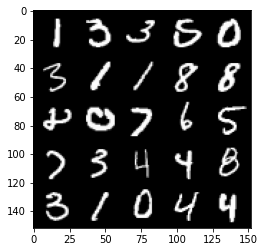

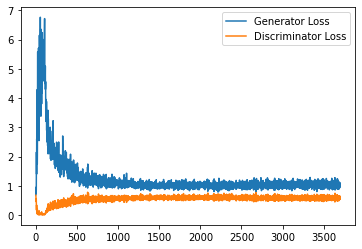

Step 74500: Generator loss: 1.036478833079338, discriminator loss: 0.5836641517877579


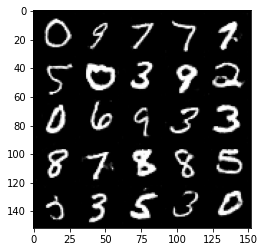

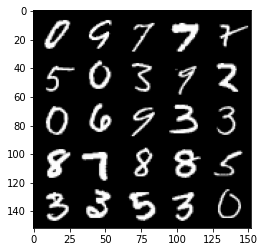

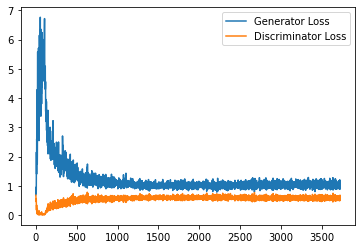

Step 75000: Generator loss: 1.0293130595684052, discriminator loss: 0.589201444029808


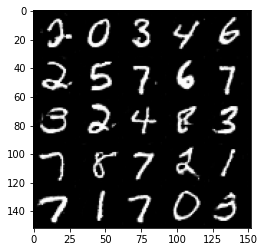

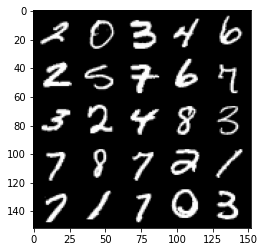

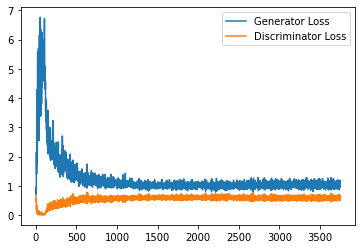

Step 75500: Generator loss: 1.044015255331993, discriminator loss: 0.5860428829193115


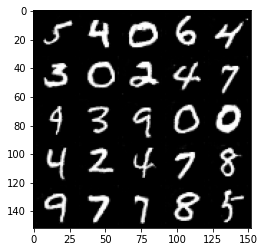

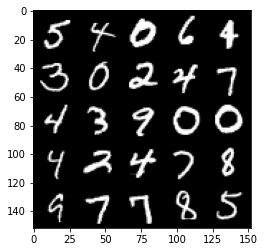

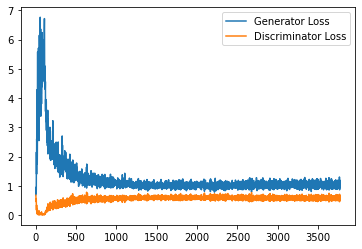

Step 76000: Generator loss: 1.035930832862854, discriminator loss: 0.5845233611464501


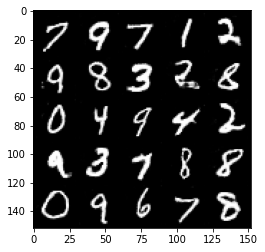

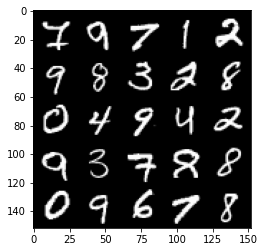

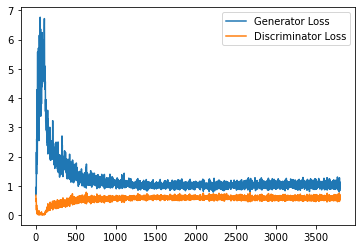

Step 76500: Generator loss: 1.0420382970571518, discriminator loss: 0.5807361268997192


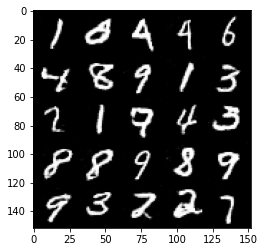

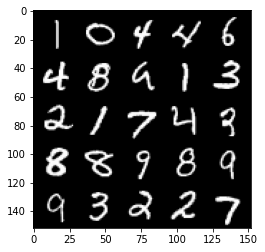

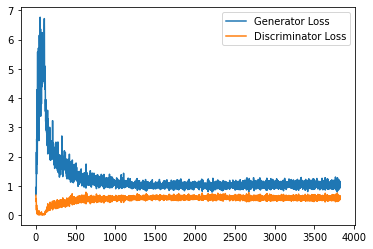

Step 77000: Generator loss: 1.042789635539055, discriminator loss: 0.5812325190901756


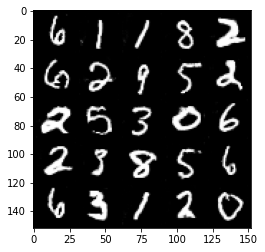

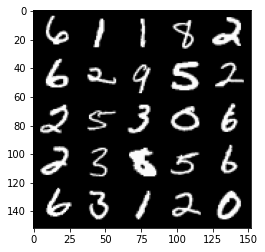

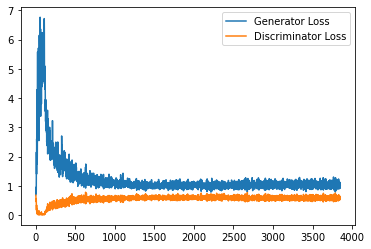

Step 77500: Generator loss: 1.0143533967733382, discriminator loss: 0.587523378431797


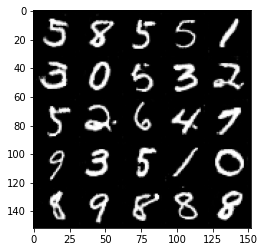

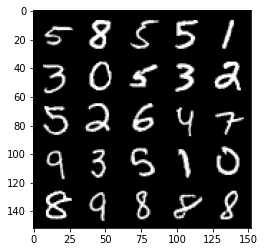

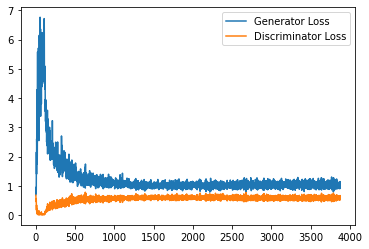

Step 78000: Generator loss: 1.0342084780931473, discriminator loss: 0.5827029839158058


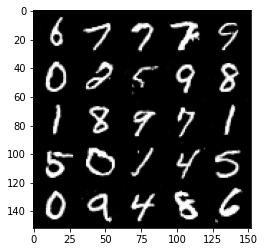

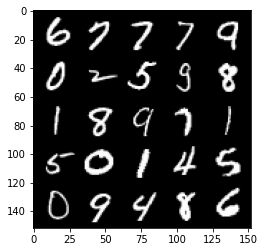

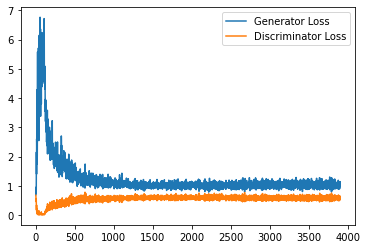

Step 78500: Generator loss: 1.0200292565822602, discriminator loss: 0.589118319272995


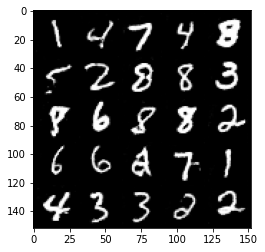

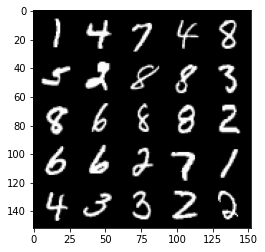

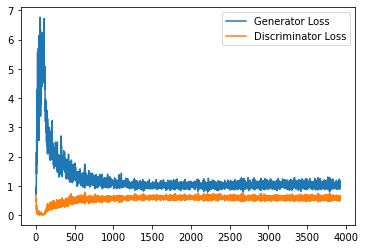

Step 79000: Generator loss: 1.036991979956627, discriminator loss: 0.5877726662755013


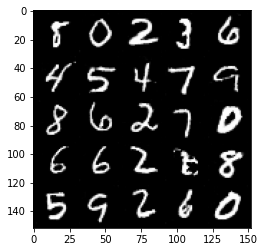

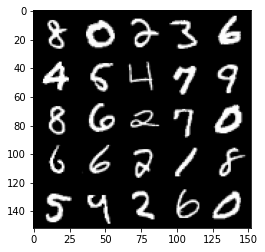

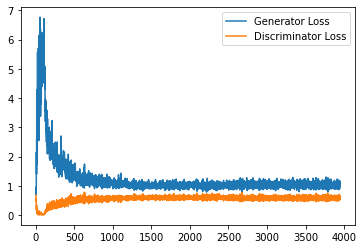

Step 79500: Generator loss: 1.0341912455558777, discriminator loss: 0.5897302863001823


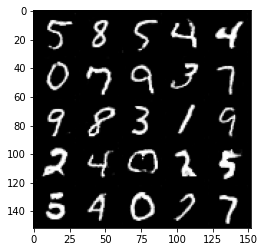

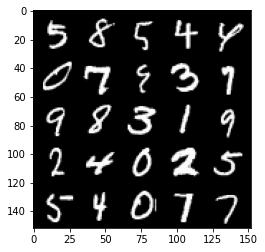

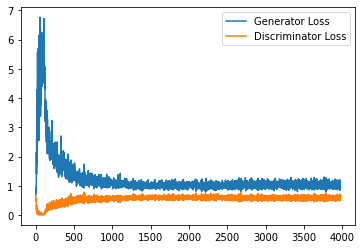

Step 80000: Generator loss: 1.0284358497858048, discriminator loss: 0.5909569495916367


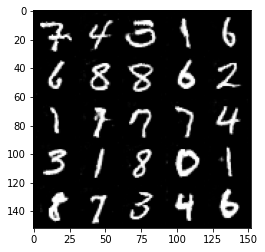

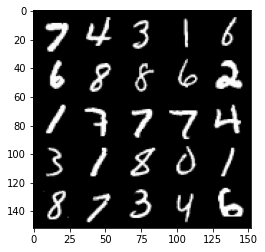

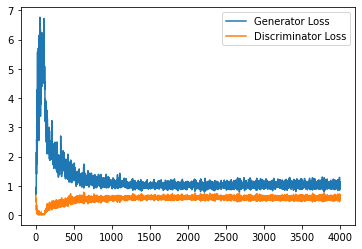

Step 80500: Generator loss: 1.044716391801834, discriminator loss: 0.5863488058447838


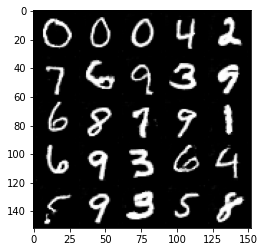

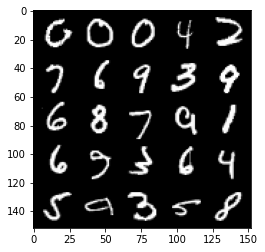

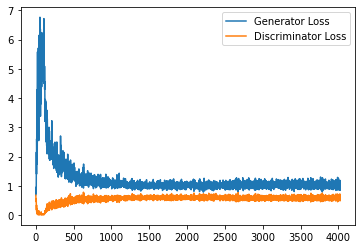

Step 81000: Generator loss: 1.0209543064832687, discriminator loss: 0.5897623571753502


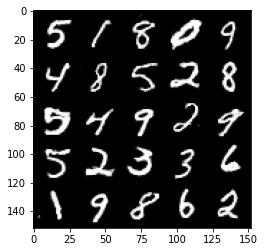

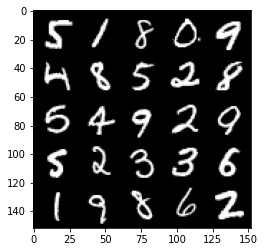

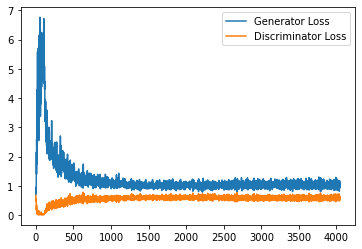

Step 81500: Generator loss: 1.0403233501911164, discriminator loss: 0.5882060136198998


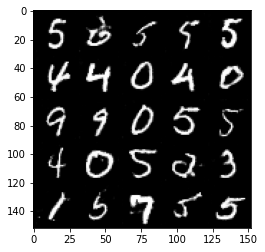

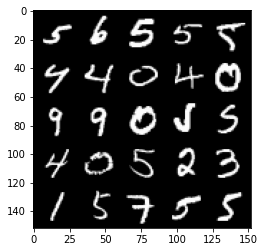

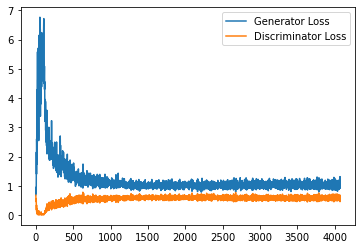

Step 82000: Generator loss: 1.0263386101722718, discriminator loss: 0.5887435863018036


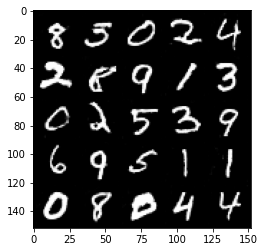

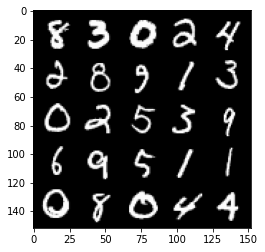

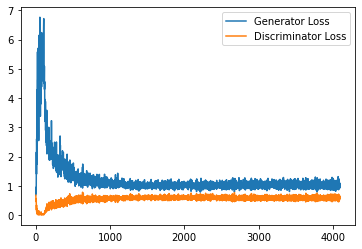

Step 82500: Generator loss: 1.0237585586309432, discriminator loss: 0.5876355782151222


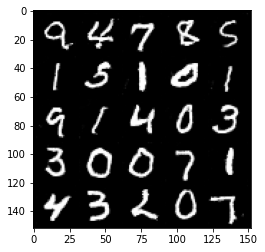

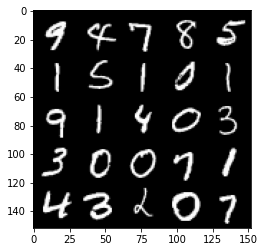

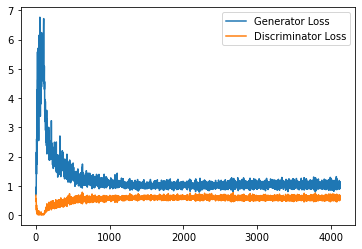

Step 83000: Generator loss: 1.0329192751646041, discriminator loss: 0.5922395690083504


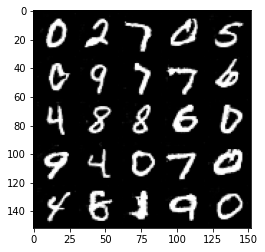

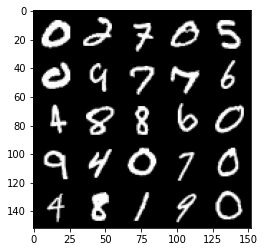

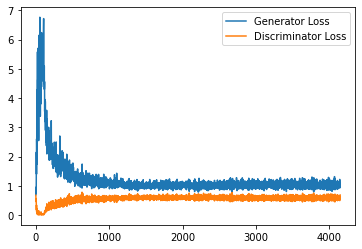

Step 83500: Generator loss: 1.0477187911272048, discriminator loss: 0.5887313687205314


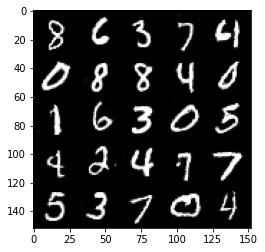

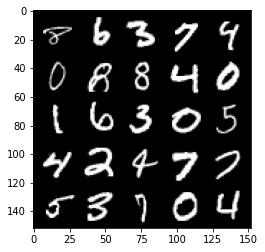

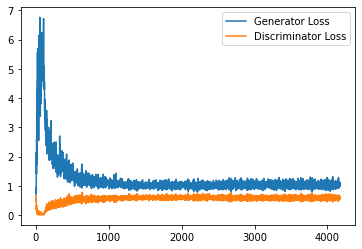

Step 84000: Generator loss: 1.0218716868162154, discriminator loss: 0.5896711686253547


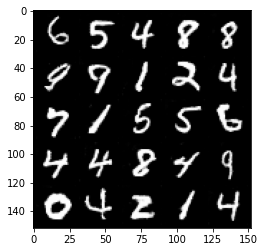

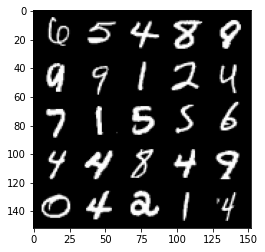

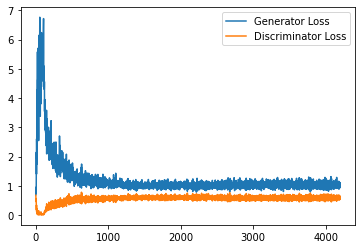

Step 84500: Generator loss: 1.0189676052331924, discriminator loss: 0.5956473135948182


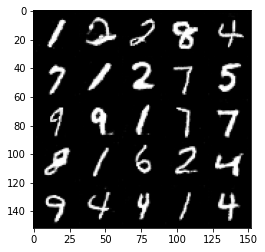

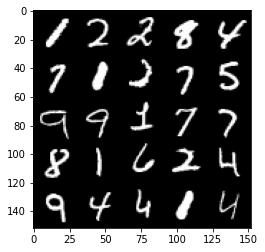

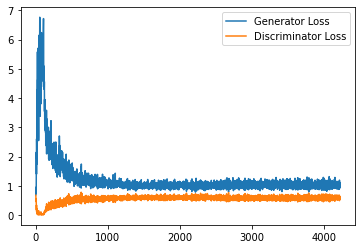

Step 85000: Generator loss: 1.0314899319410324, discriminator loss: 0.5911855286359787


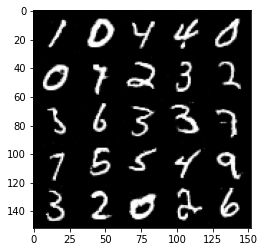

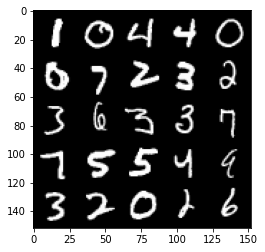

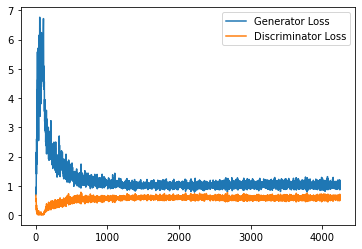

Step 85500: Generator loss: 1.0099185453653337, discriminator loss: 0.5883940334916115


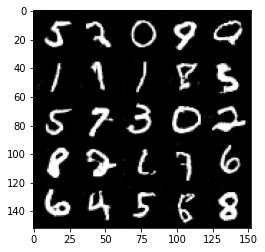

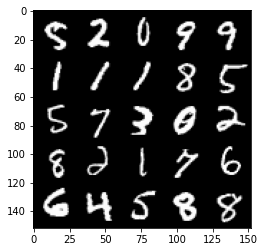

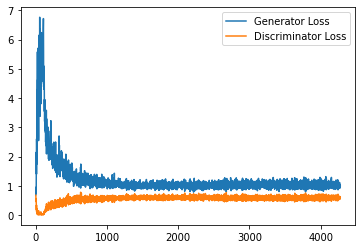

Step 86000: Generator loss: 1.0177509496212005, discriminator loss: 0.5910575675964356


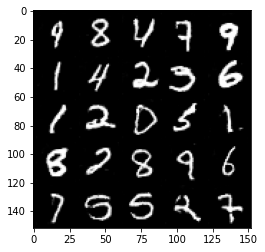

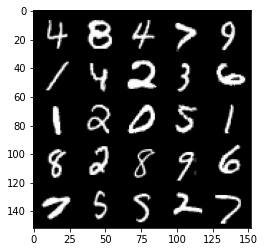

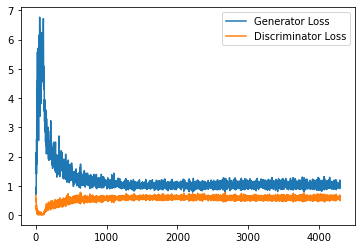

Step 86500: Generator loss: 1.025229883313179, discriminator loss: 0.593580183327198


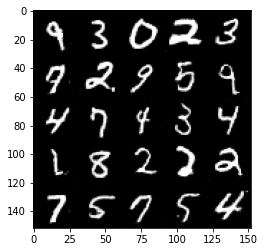

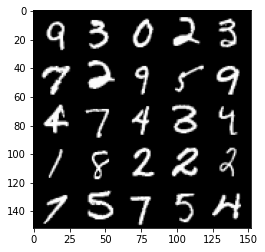

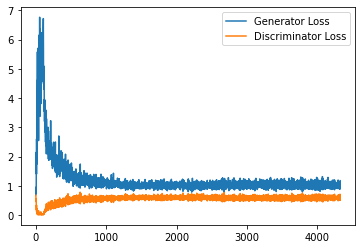

Step 87000: Generator loss: 1.0310105865001677, discriminator loss: 0.5964023915529251


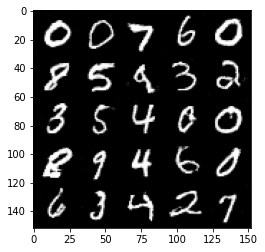

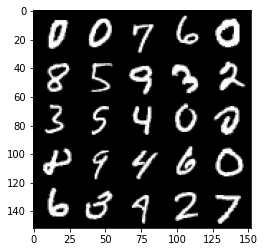

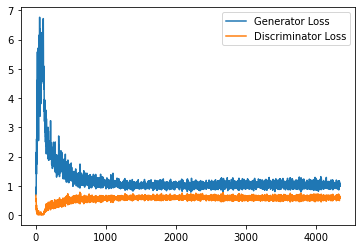

Step 87500: Generator loss: 1.0273478835821153, discriminator loss: 0.5912154403924942


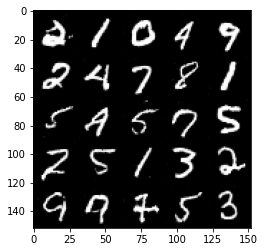

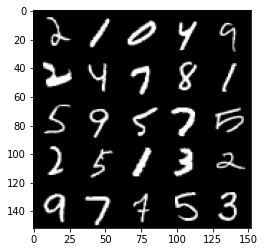

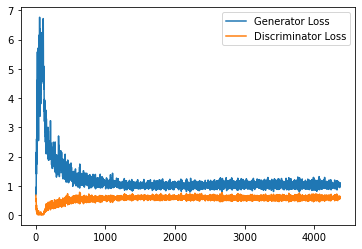

Step 88000: Generator loss: 1.0164419006109238, discriminator loss: 0.5997419269680977


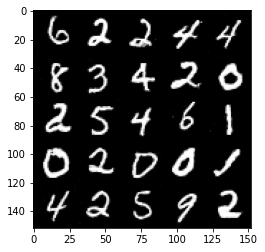

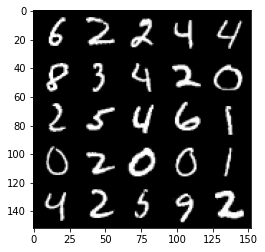

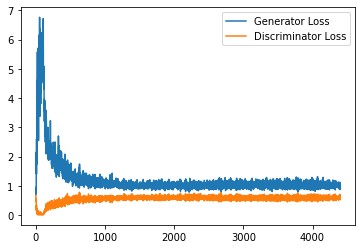

Step 88500: Generator loss: 1.0177500652074813, discriminator loss: 0.5961078281998634


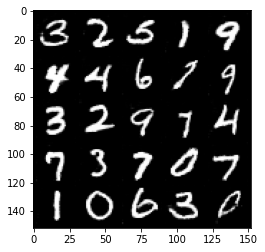

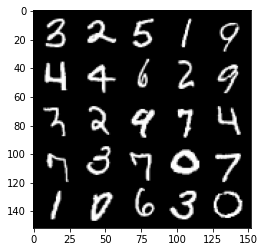

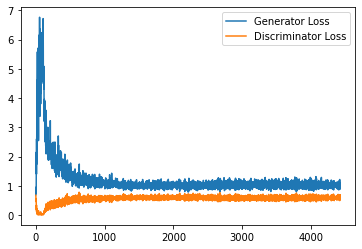

Step 89000: Generator loss: 1.0175217853784562, discriminator loss: 0.5919541395902633


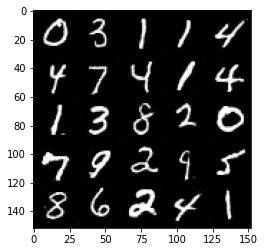

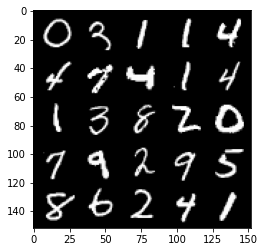

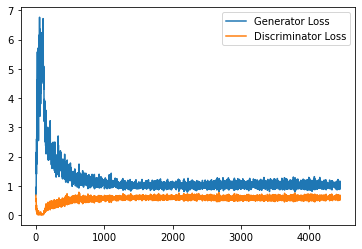

Step 89500: Generator loss: 0.9992359021902084, discriminator loss: 0.5977430404424667


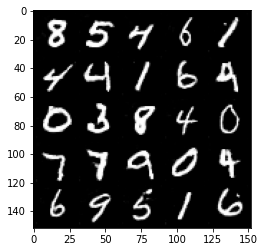

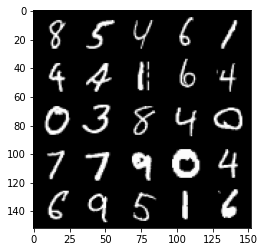

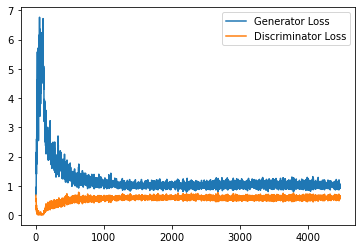

Step 90000: Generator loss: 1.011112209558487, discriminator loss: 0.5910048144459724


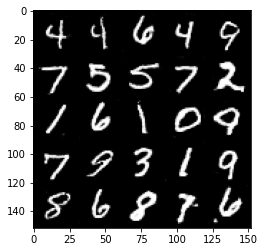

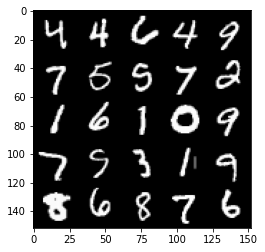

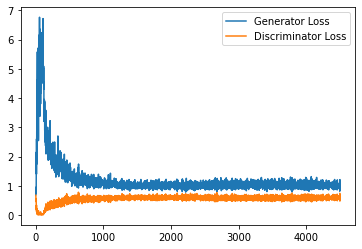

Step 90500: Generator loss: 1.018944986820221, discriminator loss: 0.5983451086282731


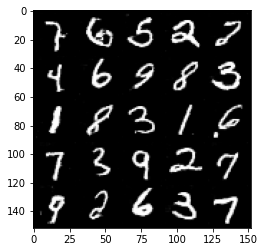

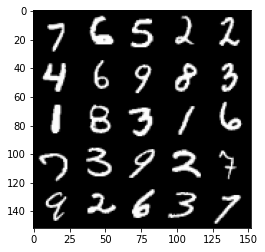

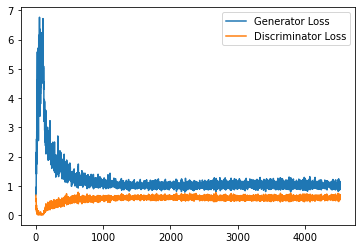

Step 91000: Generator loss: 1.04114466881752, discriminator loss: 0.5926272724866867


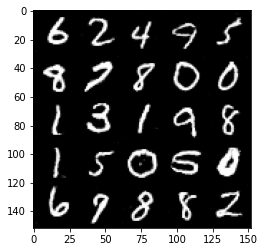

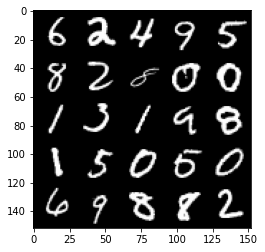

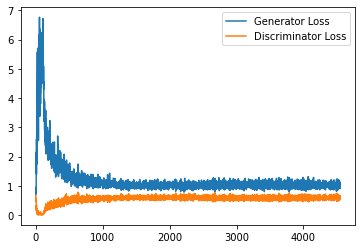

Step 91500: Generator loss: 1.0383735393285751, discriminator loss: 0.596449405670166


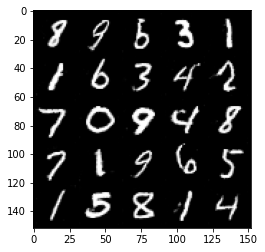

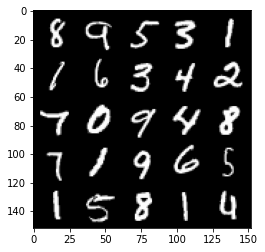

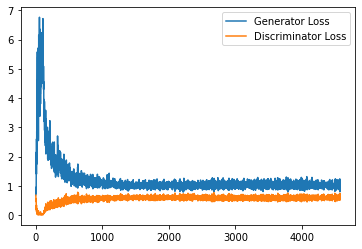

Step 92000: Generator loss: 1.0075987951755523, discriminator loss: 0.5999338948726654


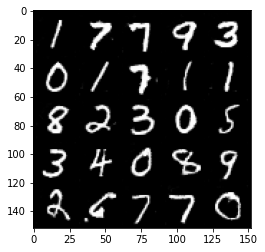

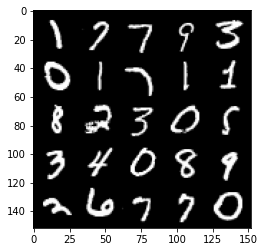

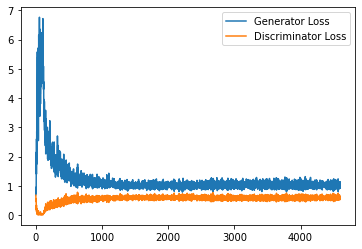

Step 92500: Generator loss: 0.9965668656826019, discriminator loss: 0.595040783405304


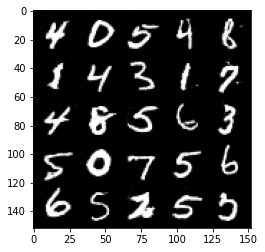

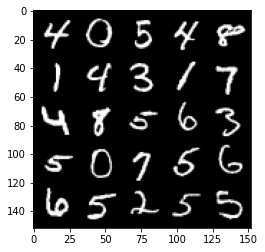

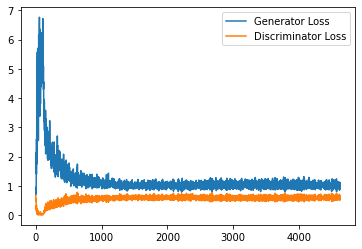

Step 93000: Generator loss: 1.0165322737693787, discriminator loss: 0.5994705226421356


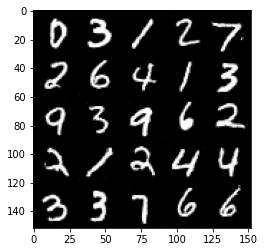

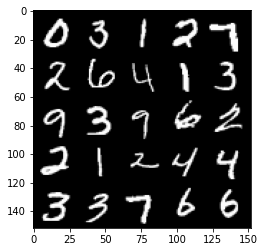

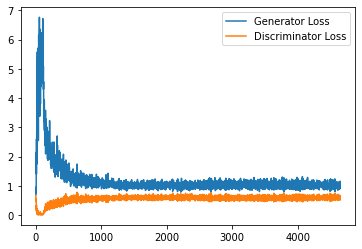

Step 93500: Generator loss: 1.0054530307054519, discriminator loss: 0.6000410431623459


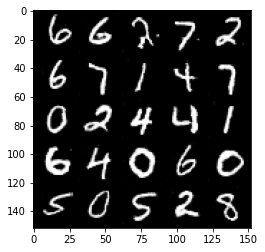

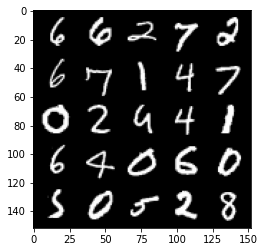

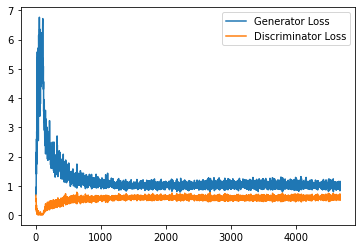

In [13]:
# Training
cur_step = 0
generator_losses = []
discriminator_losses = []

noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so we do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
       
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if we didn't concatenate our labels to our image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations!")
        cur_step += 1